# Формализация задачи и EDA

Задание:
1. Проработать проблематику (чем подобного рода проблемы могут грозить бизнесу)
2. Формализоавть задачу
3. Проанализировать имеющиеся данные и оценить их пригодность для решения поставленной задачи.

# Описание проблематики

Рассмотрим проблематику в разрезе маркетплейса. Маркетплейс - это онлайн платформа, которая позволяет продавцам предлагать и продавать свой товар, а покупателям проводить поиск интересующих его товаров и, соответственно, их покупать. Задача маркетплейса - обеспечить удобство пользования платформой, быстроту и простоту совершения сделок. Это позволяет обеспечить приятный пользовательский опыт, приобрести пользовательскую лояльность и, в дальнейшем, повышать количество продаж и выручку. В противном случае можно потерпеть серьезные убытки. К важным аспектам при использовании маркетплейса можно отнести, в частности, следующее: поиск товара должен выдавать релевантные результаты; маркетплейс должен предлагать покупателю варианты товара, которые наиболее вероятно ему сейчас необходимы, или которые похожи на то, что он искал ранее, что покупают другие пользователи с похожими запросами и т.п.. Достичь этого можно в том случае, если имеется полноценное понимание "что из себя представляет товар". Как получить данное "понимание"? Один из вариантов, который и будет использоваться в данной работе - это построение мультимодальных эмбеддингов, основанных на получаемых изображениях товара, его описания, характеристиках и т.п. Они должны быть такими, чтобы похожие товары, например по (под-)категории, ценовому диапазону, полу (мужской/женский), возрасту (для детей/взрослых) и т.п. в векторном пространстве имели наименьшее расстояние между собой. Помимо уже указанной релевантности поиска и предложения покупателю похожих товаров это также поможет проверять правильность указанной продавцом информации о товаре или вовсе проводить автоматическое заполнение части данных, что ускорит загрузку товаров на платформу.

В данной работе необходимо построить мультимодальные эмбеддинги на основе информации из карточки товара: заголовка (текст), описания (текст) и изображения. Для решения данной задачи хорошо подходят так называемые Fusion модели. Они представляют собой объединие двух или более нейронных сетей, каждая из которых отвечает за получение скрытых векторов определенной модальности (текст, изображение, аудио, видео). Они классифицируются на группы, по принципу "когда" происходит объединение получаемых от моделей данных:
- *decision-level (late) fusion*: каждая модель по отдельности выдает свое решение задачи, затем эти данные интегрируются на основе чего в итоге получается конечное решение;
- *feature-level (early) fusion*: получаемые от каждой модели внутренние состояния конкатенируются, решение строится на основе сконкатеннированного вектора;
- *mid-level (hybrid) fusion*: отчасти объединяет в себе оба подхода.

![[fusion.png]](https://www.ncbi.nlm.nih.gov/corecgi/tileshop/tileshop.fcgi?p=PMC3&id=313180&s=161&r=1&c=1)

Построенная нами модель должна будет хорошо классифицировать товар по категории, подкатегориям, наличию возрастных ограничений, для какого пола он преназначен, а также проводить оценку цены товара. Для supervised обучения модели требуется наличие размеченных данных, однако в train датасете они отсутствуют. Для получения эмбеддингов, которые будут сгруппированы по семантически значимым характеристикам, будут применяться методы кластеризации. Для оценки качества кластеризации необходимо будет применять прокси-метрики на основе информации, доступной в карточке товара.

**Литература по теме**:
- [Deep learning-based late fusion of multimodal information for emotion classification of music video | Springer Link](https://link.springer.com/article/10.1007/s11042-020-08836-3)
- [Awesome-self-supervised-multimodal-learning | GitHub](https://github.com/ys-zong/awesome-self-supervised-multimodal-learning)

# Формализация

**Цель**: получить модель, которая будет выдавать мультимодальные эмбеддинги, качественно описывающие товар. 

**Качество модели**: измеряется с использованием прокси-метрик (категория, подкатегория, ценовый диапазон, пол, для взрослого/ребенка, товар исключительно для взрослых), для расчета которых используются `F1`, `precision`, `MSE` и т.п.  

**Данные**:<br>
Доступно два набора табличных данных:
1. Данные для обучения `wb_school_tran.parquet`: изображение, заголовок, описание, характеристики
2. Данные для валидации `wb_school_test.parquet`: изображение, заголовок, описание, характеристики, категория, подкатегория, ценовой диапазон

Название колонки | описание
---|---
nm | уникальный идентификатор
title | текстовый заголовок товара
description | развернутое текстовое описание товара
category | общая категория товара, выбираетс япри создании карточки человеком
sub_catergory | category с большим количсетвом уточненных классов
isadult | является ли товар товаром для взрослых
brand | имя бренда производителя товара

Изображения предоставляются в формате сжатого `.zip` архива `wb_school_horizcv_images.zip`. Название изображения - это уникальный идентификатор `nm` + его формат (`.jpg`).

**Задачи**:<br>
1. *Анализ имеющихся данных*: оценить пригодность данных для решения поставленной задачи, выделить важные признаки, выделить возможные таргеты, свести к минимуму артефакты в данных;
2. *Проработка вариантов решения*: поиск и выбор наиболее подходящего решения задачи,  формирование обучающей выборки и схемы валидации;
3. *Построение базовых моделей*: выбор метрики для оценки качества модели, выбор и реализация базовых решений, выбор одного решения для дальнейшей оптимизации;
4. *Оптимизация решения*
5. *Построение финального пайплайна*: включает в себя этапы подготовки данных, обучения модели и подсчета метрик, подготовка итоговой презентации.

**Результат работы**: jypyter-ноутбуки, python-скрипты, итоговая презентация.

# Explanatory Data Analysis

In [1]:
# подключаем все необходимые библиотеки
import io
import re
import zipfile
import pandas as pd
import numpy as np
from string import punctuation
from collections import Counter, defaultdict

from PIL import Image
import matplotlib.pyplot as plt
import seaborn as sns

import spacy
import ru_core_news_sm
import nltk

from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from scipy.stats import normaltest
from get_image_size import get_image_size_from_bytesio

from tqdm.notebook import tqdm
from wordcloud import WordCloud
import swifter
import warnings

In [2]:
# сделаем возможным параллельную обработку строковых колонок в pd.DataFrame
swifter.set_defaults(
    allow_dask_on_strings=True,
)

# зададим стиль графиков
sns.set(style='darkgrid', font_scale=1.1)

# загрузим стоп-слова
nltk.download('stopwords')

# подключаем progress bar для pandas
tqdm.pandas()

# отключаем вывод предупреждений
warnings.filterwarnings('ignore')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Sergei\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Соберем в одном месте все функции и классы, которые понадобятся для работы.

In [3]:
# глобальные параметры
path_to_files = 'D:/HorizontalML/'
path_to_zip = path_to_files + 'wb_school_horizcv_images.zip'

# словарь для перевода единиц измерения в г, см или л
coeff = {
    'г': 1,
    'мг': 1e-3,
    'кг': 1e3,
    'см': 1,
    'мм': 0.1,
    'м': 100,
    'км': 1e5,
    'л': 1,
    'мл': 1e-3,
}

In [4]:
 def plot_images(path_to_zip: str, 
                 file_names: list[str], 
                 bgr_to_rgb: bool = False, 
                 titles: list[str] = None, 
                 main_title: str = None, 
                 cols: int = 5, 
                 hspace: float = 0.) -> None:
    """
    Построения набора изображений из списка file_names, расположенных в архиве path_to_zip.
    """
    
    # чтобы не разархивировать все картинки воспользуемся модулем zipfile
    with zipfile.ZipFile(path_to_zip) as zf:
        # определяем сколько понадобится строк для вывода изображений
        rows = len(file_names) // cols if len(file_names) % cols == 0 else len(file_names) // cols + 1
        
        fig, axes = plt.subplots(rows, cols, figsize=((cols + hspace) * 2.3, rows * 3), gridspec_kw={'hspace': hspace, 'wspace': 0})
        plt.suptitle(main_title, fontsize=14)
        axes = axes.flatten()
        
        for i, file_name in enumerate(file_names):
            img = Image.open(zf.open(file_name))
            
            if bgr_to_rgb:
                img = np.array(img)[:,:,::-1]  # bgr to rgb
                
            axes[i].imshow(img)
            axes[i].axis('off')
            
            if titles is not None:
                axes[i].set_title(titles[i], fontsize=10)

        plt.show()

        
def get_main_info(df: pd.DataFrame) -> None:
    """
    Отображение основной информации по датасету.
    """
    
    # основная информация
    df.info(memory_usage='deep')
    
    # количество и процент пропусков
    print('\nПропуски в колонке:')
    for col in df.columns:
        print(f'{col:>15}: {df[col].isna().sum():>3} ({df[col].isna().mean():.2%})')
    
    # количество и процент дубликатов
    if 'characteristics' in df.columns:
        cols = ['nm', ['title', 'description', 'characteristics'], ['title', 'description'], 'title', 'description', 'characteristics']
    else:
        cols = ['nm', ['title', 'description'], 'title', 'description']
        
    print('\nЧисло полностью дублируюшихся записей:', df.duplicated().sum())
    print('Число дубликатов по:')
        
    for col in cols:
        col_str = ', '.join(col) if isinstance(col, list) else col
        print(f'{col_str:>35}: {df.duplicated(col).sum():>5} ({df.duplicated(col).mean():.2%})')
    
    # вывод случайных записей
    print('\nЗаголовок и описание 8-ми случайных записей:')
    print('=' * 100, '\n')
    
    for line in df.sample(8, random_state=42).itertuples():
        print('Title:', line.title)
        print('\nDescription:', line.description)
        print('=' * 100, '\n')
    
        
def show_dup_pairs_by_images(df: pd.DataFrame, 
                             cols: list[str], title: str = None, 
                             path_to_zip: str = path_to_zip) -> None:
    """
    Отображение пар изображений, для которых в указанных колонках cols в датафрейме df обнаружены дубликаты.
    """
    
    # сортируем по указанным колонкам
    df = df.sort_values(by=cols)
    
    dups = df[df.duplicated(cols, keep=False)].copy()
    
    # пронумеруем дубликаты
    dups['rank'] = dups.groupby(cols)[['nm']].rank()
    dups = dups.sort_values(by=cols, ascending=False)
    
    # в каждом наборе дубликатов ввыберем только пару (чтобы было удобно сравнивать)
    nm_dups = dups[dups['rank'].isin([1, 2])].iloc[:12, 0]
    
    # пересортируем таким образом, чтобы вначале была строка с изображениями разных товаров
    # а следующая - их дубликаотов
    nm_dups = pd.concat([nm_dups[::2], nm_dups[1::2]]) 

    plot_images(path_to_zip, nm_dups.apply(lambda x: str(x) + '.jpg'), titles=nm_dups.values, cols=6, bgr_to_rgb=True, hspace=0.1,
               main_title=title)
    
    
def plot_lengths_distributions(data: pd.DataFrame, 
                               column: str,
                               data_2: pd.DataFrame = None,
                               labels: list[str] = None) -> None:
    """
    Построение распределений по длине текста и по количеству слов.
    """
    if labels is None:
        labels = [None, None]
    
    fig, ax = plt.subplots(1, 2, figsize=(15, 5))

    ax = ax.flatten()

    ax[0].hist(train[column].str.len(), bins=50, label=labels[0], alpha=0.8)
    if data_2 is not None:
        ax[0].hist(data_2[column].str.len(), bins=50, label=labels[1], alpha=0.8)
        ax[0].legend()
        
    ax[0].set_title(f'Распределение по длинам {column}')
    ax[0].set_ylabel('Count')
    ax[0].set_xlabel(f'Length of {column}')
    
    # подсчет количества слов будет проводиться грубо, простым разделением по пробелу
    ax[1].hist(train[column].apply(lambda x: len(x.split()) if x is not None else 0), bins=20, label=labels[0], alpha=0.8)
    if data_2 is not None:
        ax[1].hist(data_2[column].apply(lambda x: len(x.split()) if x is not None else 0), bins=20, label=labels[1], alpha=0.8)
        ax[1].legend()
        
    ax[1].set_title(f'Распределение по количеству слов в {column}')
    ax[1].set_ylabel('Count')
    ax[1].set_xlabel(f'Number of words in {column}')

    plt.show();
    

def plot_wordclouds(data: dict[str, int],
                    title: str = None) -> None:
    """
    Построение облака слов.
    """
    
    wc = WordCloud(width=1000, height=600, background_color='white').generate_from_frequencies(data)
    
    plt.figure(figsize=(11, 11))
    plt.imshow(wc)
    plt.axis('off')
    plt.title(title, fontsize=20)
    plt.show();
    
    
def calc_ngram_freqs(data: pd.DataFrame, 
                     ngram_range: tuple[int, int] = (2, 3)):
    """
    Вычисление частотности слов/n-грамм.
    """
    
    cvectorizer = CountVectorizer(ngram_range=ngram_range)
    cvectorizer.fit(data.dropna())

    word_counts = cvectorizer.transform(data.dropna()).sum(axis=0)
    word_freqs = [(word, word_counts[0, idx]) for word, idx in cvectorizer.vocabulary_.items()]
    word_freqs = pd.DataFrame(word_freqs, columns=['word', 'count'])
    
    return word_freqs


def plot_freqs(data: pd.DataFrame, 
               col_names: list[str] = ['word', 'count'], 
               title: str = None):
    """
    Построение графика встречаемости слов/n-грамм.
    """
    
    pd.DataFrame(data=data, columns=col_names).sort_values(by='count', ascending=False)\
    .head(50).plot(kind='bar', x=col_names[0], y=col_names[1], figsize=(15, 5))
    plt.title(title)
    plt.xlabel(None)
    plt.show();
    

def plot_pie(values: pd.Series, 
             title: str, 
             labels: list = None, 
             autopct: str = None) -> None:
    """
    Построение круговой диаграммы.
    """
    
    plt.pie(values, labels=labels, autopct=autopct)
    plt.title(title)
    plt.show();
    
    
def show_freq_analysis(df: pd.DataFrame, 
                       col_names: list[str], 
                       titles: list[str] = None) -> list:
    """
    Вывод графиков встречаемости слов/n-грамм.
    """
    exclude = ['мг', 'г', 'кг', 'мл', 'л', 'мм', 'см', 'м', 'км', 'шт', 'штук'] + nltk.corpus.stopwords.words('russian')
    ngrams = []
    
    for i, col in enumerate(col_names):
        data = df.dropna()[col].apply(lambda x: re.sub(r'[^\w\s]', '', x).lower())
        wcounter = Counter(' '.join(data).split())
        
        # в текстах будет очень много стоп-слов, пунктуации и т.п, поэтому при анализе отдельных слов мы это исключим из рассмотрения
        wcounter_clean = Counter({w: c for w, c in wcounter.items() if w not in exclude and not w.isdigit()})
        
        plot_wordclouds(wcounter_clean, f'Наиболее частотные слова в {titles[i]} без стоп-слов и пунктуации')
        plot_freqs(wcounter_clean.items(), title=f'Наиболее частотные слова в {titles[i]} без стоп-слов и пунктуации')
    
        # также посчитаем встречаемость словосочетаний уже со стоп-словами
        ngram = calc_ngram_freqs(data, ngram_range=(2, 3))
        ngrams.append(ngram)
        
        plot_freqs(ngram, title=f'Наиболее частотные би- и триграммы в {titles[i]}')
        
    return ngrams

def process_characteristics(text: str) -> list[dict]:
    """
    Декодирование характеристик.
    """
    
    text = text.decode('utf-8')
    
    # первый паттерн
    if '\'b\\\'' in text:
        return eval(re.sub(r'\\+', r'\\', text)[5:-3].replace('true', 'True').replace('false', 'False'))
    
    # второй паттерн
    text = text.replace("}\n", "},")
    text = re.sub(r'\n\s+', ' ', text)
    text = re.sub(r'array', 'np.array', text)
    
    return eval(text)


def get_characteristic(char_list: list[dict], 
                       char_names: list[str]) -> float|list[float]:
    """
    Извлечение значений характеристик из списка char_list, которые обладают названиями char_names.
    """
    
    for char in char_list:
        if char['charcName']  in char_names:
            
            if 'value' in char and char['value'] is not None:
                if isinstance(char['value'], str):
                    char['value'] = float(char['value'].replace(',', '.'))
                    
                return char['value'] * coeff[char['unitName']]
            
            if 'charcValues' in char and char['charcValues'] is not None:
                if len(char['charcValues']) == 1:
                    return char['charcValues'][0]

                return list(char['charcValues'])
            

def get_from_list(x: list[str]|str, 
                  params_seq: list[str]) -> float|int|str:
    """
    Обработка характеристик, где встречается несколько значения списком.
    """
    
    if isinstance(x, list):
        for param in params_seq:
            if param in x:
                return param
            return x[0]
    
    return x

In [5]:
# трансформер для лемматизации текста и извлечения именованных сущностей
class TextNormalizer(BaseEstimator, TransformerMixin):
    """
    Трансформер для лемматизации текста.
    """
    
    def __init__(self):
        self.nlp = ru_core_news_sm.load()
        
    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None, ner=False, swifter=True):
        if swifter:
            res = X.swifter.apply(lambda x: self.lemmatize_text(x, ner))
        else:
            res = X.progress_apply(lambda x: self.lemmatize_text(x, ner))
        
        if ner:
            df = pd.DataFrame()
            df[0] = res.apply(lambda x: x[0])
            df[1] = res.apply(lambda x: x[1])
            return df
        
        return res
    
    def lemmatize_text(self, text, ner):
        if text is None and ner:
            return [None, None]
        elif text is None:
            return None
        
        doc = self.nlp(text)
        # исключаем из рассмотрения знаки препинания
        lemmas = ' '.join([token.lemma_ for token in self.nlp(text) if not token.is_punct])
        
        if ner:
            ner_res = defaultdict(list)
            
            for ent in doc.ents:
                ner_res[ent.label_].append(ent.lemma_)
            
            return [lemmas, ner_res]
        return lemmas

## Анализ изображений

Для начала посмотрим на изображения.

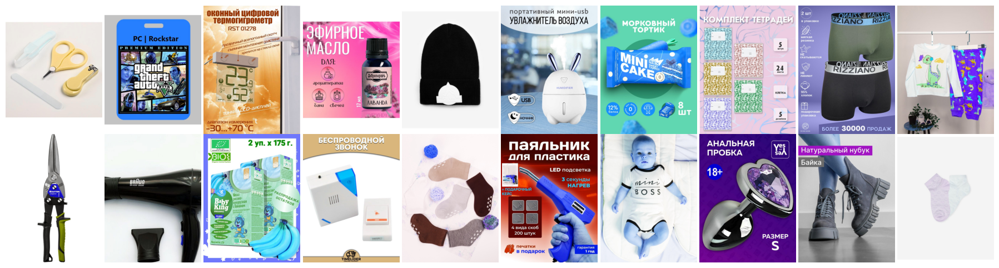

In [6]:
# чтобы не разархивировать все картинки воспользуемся модулем zipfile
with zipfile.ZipFile(path_to_zip) as zf:
    file_names = zf.namelist()
    
# выберем 20 случайных изображений
np.random.seed(101)  # для воспроизводимости
random_images = np.random.choice(file_names, 20, replace=False)

# строим случайно выбранные изображения
plot_images(path_to_zip, random_images, cols=10)

Видно, что имеется проблема с отображением цветов. По умолчанию в PIL изображения строятся использованием цветовой модели RGB. Учитывая, что человеческая кожа на картинках имеет синий цвет можно предположить, что изображения имет цветовую схему BGR (синий и красный каналы поменены местами). Чтобы изменить цветовую схему воспользуемся следующим преобразованием:
`np.array(img)[:,:,::-1]`

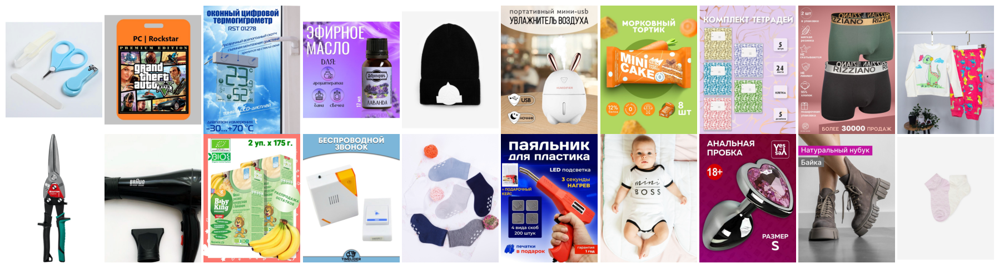

In [7]:
# строим изображения с цветовой моделью BGR (преобразование BGR to RGB уже реализовано в функции)
plot_images(path_to_zip, random_images, bgr_to_rgb=True, cols=10)

Теперь как минимум на представленных случайных изображениях цвет отображается корректно. 

На изображениях часто помимо товара добавлен текст с его описанием. В приведенных выше примерах текст не перекрывается с товаром, поэтому с ними проблем при кодировании возникнуть не должно. Однако каков бедет результат в противоположном случае - пока вопрос.

Далее получим инормацию о пространственных размерах изображений, сколько места они занимают в памяти и их идентификатор. Если использовать PIL для открытия каждой картинки и получения всей информации о ней, то это может очень сильно затянуться по времени. Для ускорения, воспользуемся решением, предложенным здесь https://github.com/scardine/image_size.

In [8]:
%%time
data = []

with zipfile.ZipFile(path_to_files + 'wb_school_horizcv_images.zip') as zf:
    file_names = zf.namelist()
    
    for file_name in tqdm(file_names):
        with zf.open(file_name) as f:
            # определяем размер изображения по горизонтали и вертикали в пикселях 
            width, height = get_image_size_from_bytesio(io.BytesIO(zf.read(file_name)), 10)
            
            # добавляем данные в список
            data.append([file_name.split('.')[0], width, height, zf.getinfo(file_name).file_size])

image_df = pd.DataFrame(data, columns=['nm', 'width', 'height', 'size'])

# сохраним данные для быстрой загрузки в случае перезагрузки ядра jupyter
# image_df.to_parquet('image_df.parquet', index=False)

  0%|          | 0/129782 [00:00<?, ?it/s]

CPU times: total: 24min 35s
Wall time: 24min 45s


In [9]:
image_df = pd.read_parquet('image_df.parquet')

In [10]:
image_df.nm = image_df.nm.astype(int)
image_df['size'] = image_df['size'] / 1024  # переводим в килобайты

display(image_df.describe())

# группируем данные по парам ширина x высота и считаем их количество
image_df.groupby(['width', 'height'])[['nm']].count().rename(columns={'nm': 'count'})

,nm,width,height,size
count,1.297820e+05,129782.000000,129782.000000,129782.000000
mean,1.051182e+08,899.931161,1199.908246,218.698560
std,5.387793e+07,4.864651,6.483912,93.875730
min,2.918080e+05,350.000000,467.000000,17.311523
25%,5.929732e+07,900.000000,1200.000000,153.868164
50%,1.130344e+08,900.000000,1200.000000,209.696777
75%,1.523150e+08,900.000000,1200.000000,270.644531
max,1.968987e+08,900.000000,1200.000000,895.592773


,,count
width,height,
350,467,1
412,550,1
422,563,1
450,600,2
480,640,2
500,667,4
512,683,1
600,800,2
609,812,1


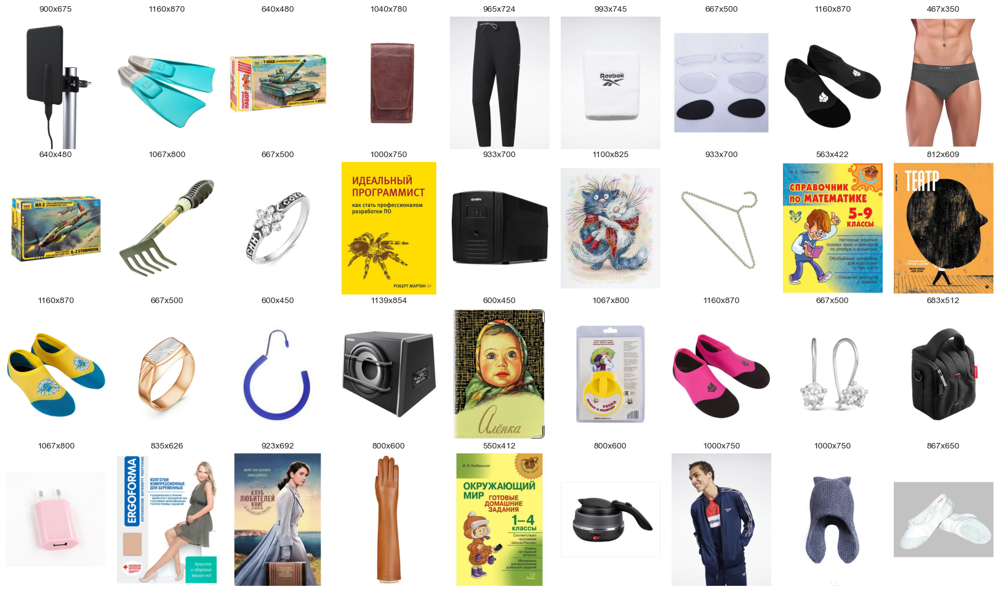

In [11]:
# выведем картинки с нестандартными размерами
plot_images(path_to_zip, image_df[image_df.height < 1200].nm.apply(lambda x: str(x) + '.jpg'),
            titles=image_df[image_df.height < 1200][['height', 'width']].apply(lambda x: f'{x[0]}x{x[1]}', axis=1).values, bgr_to_rgb=True, 
            cols=9, hspace=0.1)

Кроме различий в размерах других отличий не выявлено.

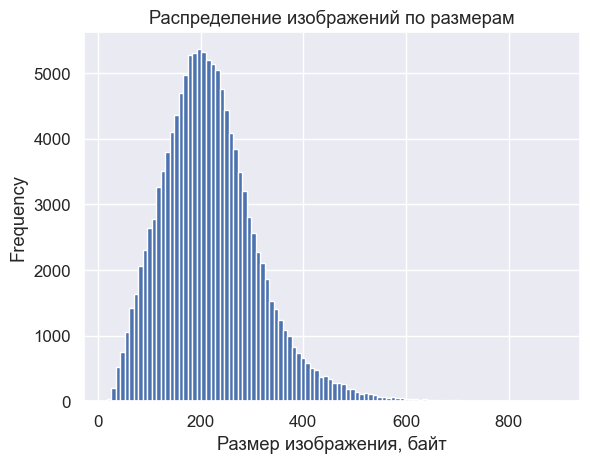

Распределение близко к нормальному: p = 2.66e-24


In [12]:
# построение распределения размеров картинок
image_df['size'].plot(kind='hist', bins=100)
plt.title('Распределение изображений по размерам')
plt.xlabel('Размер изображения, байт')
plt.show()

stats, p = normaltest(image_df['size'].sample(1000, random_state=101))
if p < 0.05:
    print(f'Распределение близко к нормальному: p = {p:.2e}')
else:
    print(f'Распределение не нормальное: p = {p:.2e}')

- большая часть изображений имеет соотношение 900 x 1200 пикселей;
- средний размер изображений составляет 218 kB, распределение изображений по размеру близко к нормальному;
- максимальный размер файла не превышает 1 MB;

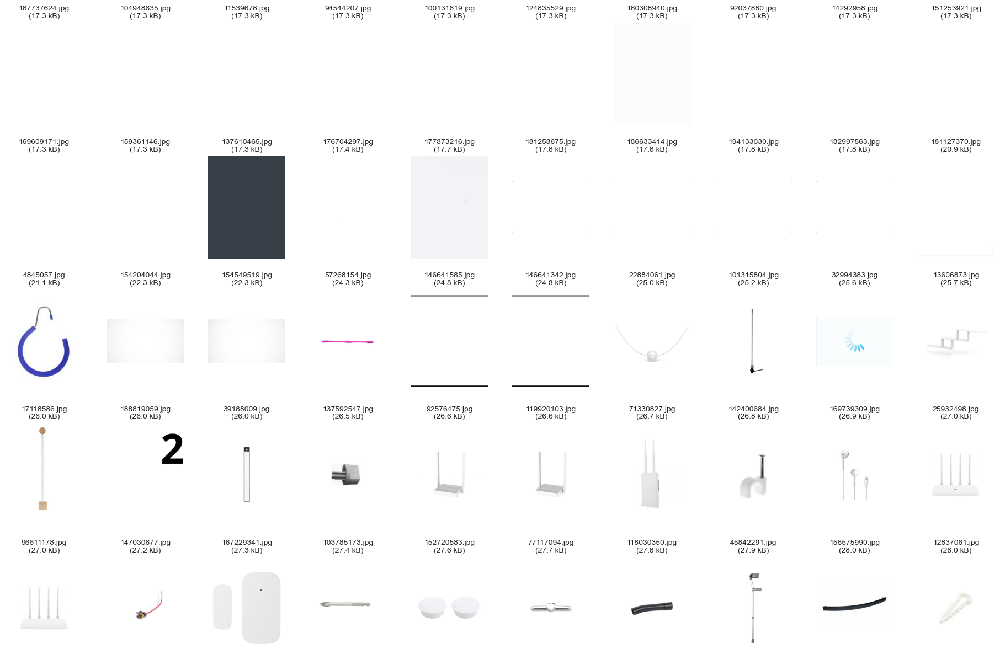

In [13]:
# посмотрим на изображения, которые имеют наименьший размер
smallest_images = image_df.sort_values(by='size').iloc[:50].copy()
smallest_images['nm'] = smallest_images['nm'].apply(lambda x: str(x) + '.jpg')
titles = smallest_images[['nm', 'size']].apply(lambda x: f'{x[0]}\n({x[1]:.1f} kB)', axis=1).values

plot_images(path_to_zip, smallest_images['nm'], titles=titles, cols=10, bgr_to_rgb=True, hspace=0.3)

Имеются пустые и бессмысленные изображения. Фильтрацию пустых изображений можно провести по размеру файла.

In [14]:
# определим идентификаторы пустых картинок
empty_nms = image_df[image_df['size'] < 25].nm

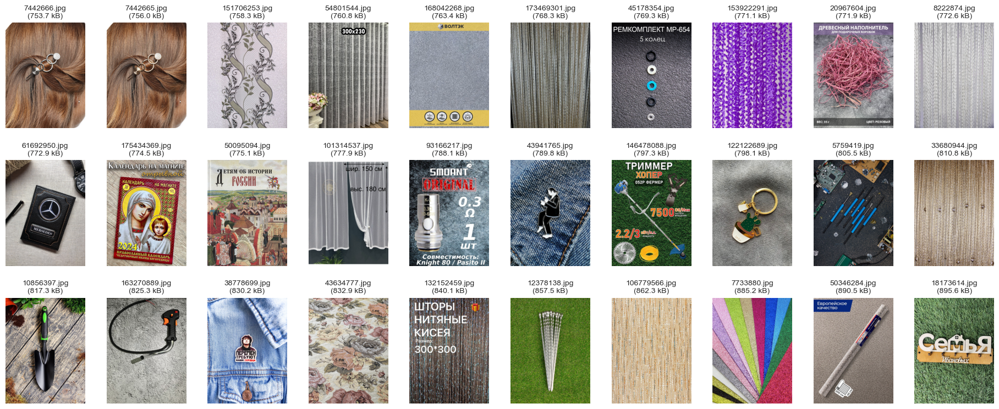

In [15]:
# посмотрим на изображения, которые имеют наибольший размер
highest_images = image_df.sort_values(by='size').iloc[-30:].copy()
highest_images['nm'] = highest_images['nm'].apply(lambda x: str(x) + '.jpg')
titles = highest_images[['nm', 'size']].apply(lambda x: f'{x[0]}\n({x[1]:.1f} kB)', axis=1).values

plot_images(path_to_zip, highest_images['nm'], titles=titles, cols=10, bgr_to_rgb=True, hspace=0.3)

Для больших (по занимаемой памяти) изображений нет заметных артефактов.

### Промежуточные выводы
- большая часть изображений имеет формат BGR и соотношение 900 x 1200 пикселей;
- средний размер изображений составляет 218 kB, распределение изображений по размеру близко к нормальному;
- максимальный размер файла не превышает 1 MB;
- изображения с размером до 21 kB пустые.

При подготовке изображений перед обучением модели необходимо будет избавиться от пустых изображений, провести трансформацию изображений, соотношение сторон которых будет 3 к 4. Если будут использоваться модели из PyTorch, необходимо будет также провести преобразование BGR в RGB.

## Загрузка train и test данных

In [151]:
# для чтения данных в формате parquet используем pandas read_parquet
train = pd.read_parquet(path_to_files + 'wb_school_train.parquet')
test = pd.read_parquet(path_to_files + 'wb_school_test.parquet')

## Анализ train данных

In [152]:
# выводим основную информацию по датасету
get_main_info(train)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99782 entries, 56869 to 55639
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   nm               99782 non-null  int64 
 1   title            99332 non-null  object
 2   description      99563 non-null  object
 3   characteristics  99782 non-null  object
dtypes: int64(1), object(3)
memory usage: 652.1 MB

Пропуски в колонке:
             nm:   0 (0.00%)
          title: 450 (0.45%)
    description: 219 (0.22%)
characteristics:   0 (0.00%)

Число полностью дублируюшихся записей: 0
Число дубликатов по:
                                 nm:     0 (0.00%)
title, description, characteristics:   294 (0.29%)
                 title, description:  5196 (5.21%)
                              title: 12588 (12.62%)
                        description:  8131 (8.15%)
                    characteristics:   365 (0.37%)

Заголовок и описание 8-ми случайных записей:

Title: Брюки 

Имеется незначительное количество пропусков в колонках title и description. Полностью дублирующихся записей нет, однако имеется заметное количество дубликатов как по паре title и description, так и в отдельности по данным колонкам.

Можно заметить, что в описании товара и/или заголовке иногда можно встретить информацию о стране производителе, бренде, названии товара. Можно попробовать использовать NER для выделения данной информации.

Сравним изображения товаров для разных комбинаций дубликатов.

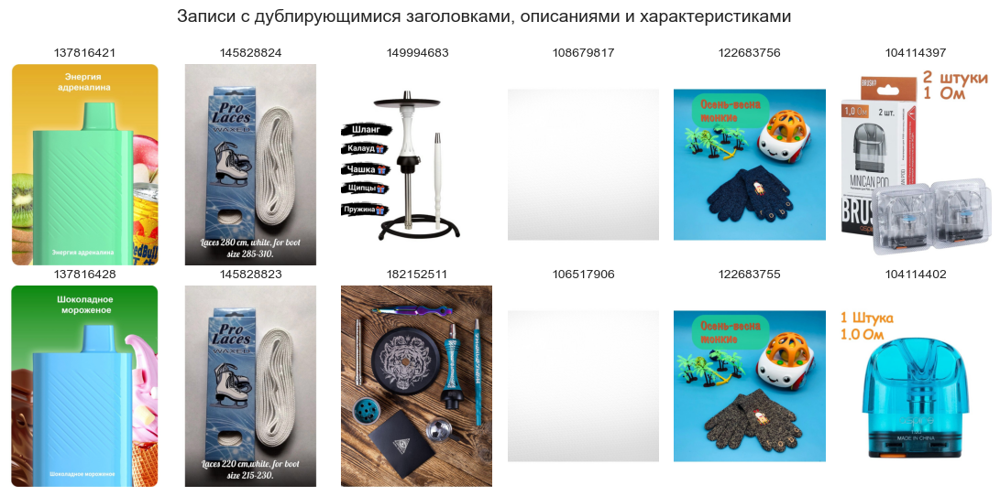

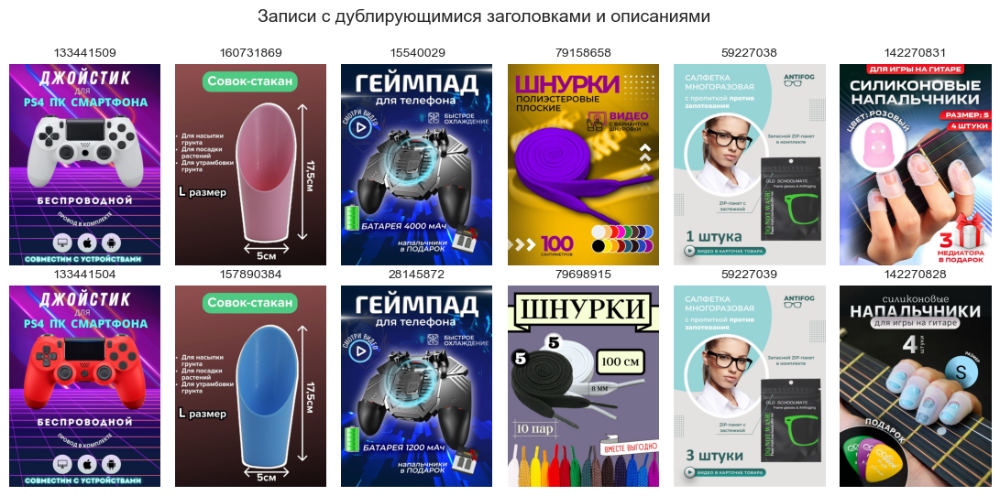

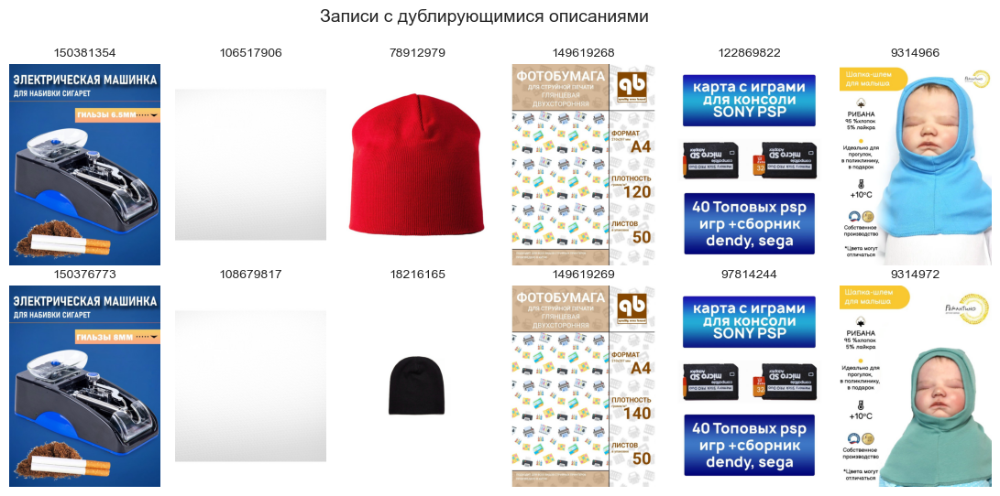

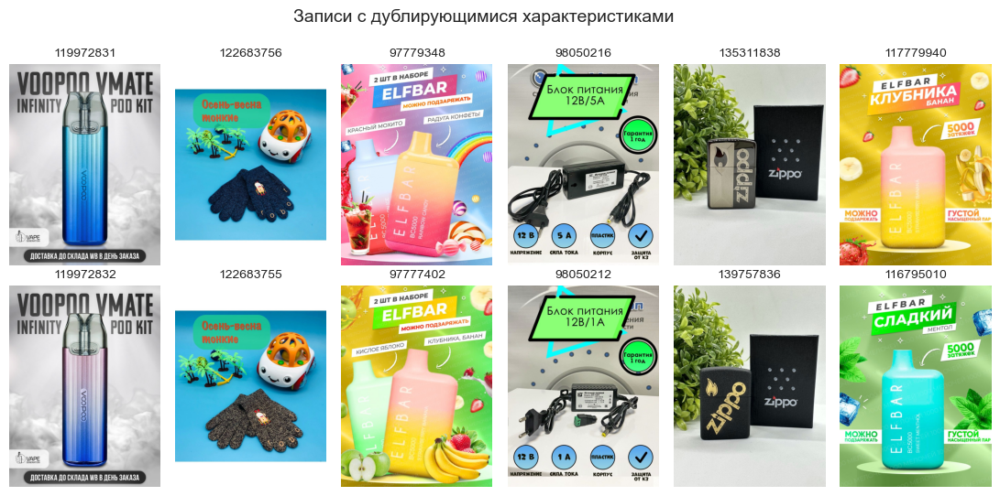

In [153]:
for dup_cols, title in [
    (['title', 'description', 'characteristics'], 'Записи с дублирующимися заголовками, описаниями и характеристиками'),
    (['title', 'description'], 'Записи с дублирующимися заголовками и описаниями'),
    (['description'], 'Записи с дублирующимися описаниями'),
    (['characteristics'], 'Записи с дублирующимися характеристиками'),
]:
    show_dup_pairs_by_images(train, dup_cols, title=title)
    print('\n')

В подавляющем числе случаев изображения для дублирующихся записей (причем как по тройке заголовок-описание-характеристики, так и по каждой колонке в отдельности) идентичны,  незначительно отличаются цвета товара, их описание на самой картинке. Иногда встречается изображение товара, который немного отличается по форме, занимает большее пространстов картинки.

В общем случае это кажется достаточно полезным. Действительно, существует множество товаров, которые немного отличаются по форме/цвету. Возможно, стоит провести аугментацию изображений для товаров с изменением цветов картинок, кропом, флипом и т.п.. 

In [154]:
# проверим, для всех ли идентификаторов nm имеются картинки
num = train.nm.isin(image_df.nm).sum()
print(f'Доля записей из test для которых имеются изображения: {num} ({num / len(train) * 100:.1f}%)')

Доля записей из test для которых имеются изображения: 99782 (100.0%)


Для каждой записи имеется файл с изображением.

In [155]:
# удалим те записи, для которых изображения - пустые
train = train[~train.nm.isin(empty_nms)]

In [156]:
# заполним пропуски в description используя title, где это возможно
train['description'] = train.description.fillna(train.title)

# удалим записи с пропусками в title, поскольку их мало
train = train.dropna(subset=['title'])

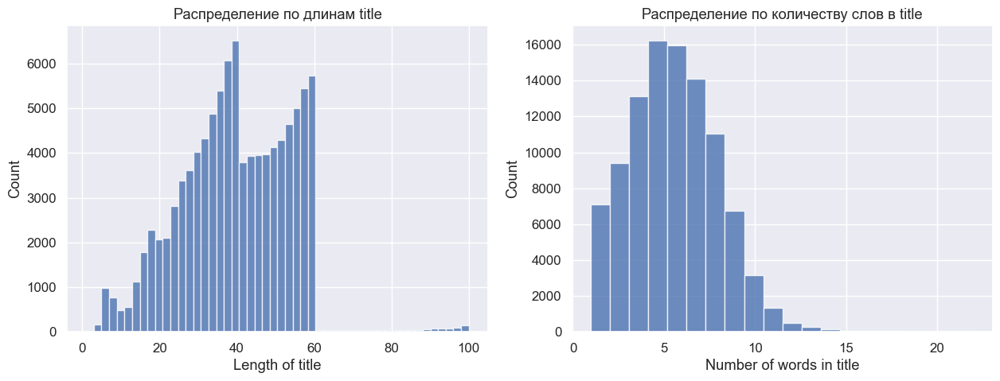

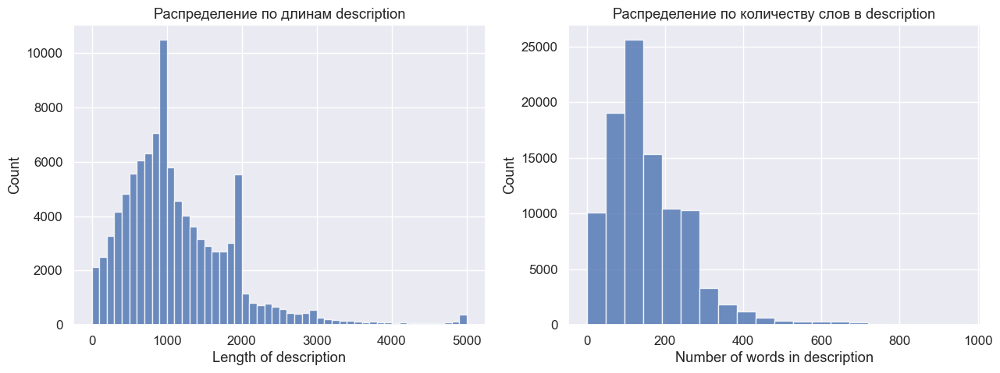

In [22]:
# получим статистику по длинам текста и количеству слов в нем
plot_lengths_distributions(train, 'title')
plot_lengths_distributions(train, 'description')

- интересно, что у распределений длин текста как в заголовках, так и в описаниях имеются несколько ярко выделяющихся границ: до 40, до 60 и до 100 символов в заголовках, до 1000, 2000, 3000 и 5000 символов в описаниях;
- распределения по количеству слов в обоих случаях близки к нормальному.

Фактор длины текста необходимо будет учитывать, если будем работать с трансформерами для получения эмбеддингов.

In [157]:
# посмотрим на записи с len(title) < 3
train[train.title.str.len() < 3]

,nm,title,description,characteristics
43823,21158909,а,,"b""[{'charcName': '\xd0\xa1\xd1\x82\xd1\x80\xd0..."
118304,127907960,1,не для продажи,"b""[{'charcName': '\xd0\x9a\xd0\xbe\xd0\xbc\xd0..."
99900,94673855,*,При подборе размера смотрите верхнюю строчку. ...,"b""[{'charcName': '\xd0\x9d\xd0\xb0\xd0\xb7\xd0..."
99024,97994857,CH,J,"b""[{'value': 200, 'unitName': '\xd0\xb3', 'cha..."
73892,156335347,LV,Привлекательная на вид и приятная на ощупь обл...,"b""[{'charcName': '\xd0\x92\xd0\xb8\xd0\xb4 \xd..."
127570,138783308,1,не для продажи,"b""[{'charcName': '\xd0\x9a\xd0\xbe\xd0\xbc\xd0..."
89745,28455850,Мы,"Знаковый роман, с которого официально отсчитыв...","b'b\'b\\\'[{""charcName"":""\\\\\\\\u0410\\\\\\\\..."


Заголовки товаров с 1 или 2 символами несколько бессмысленные (кроме романа "Мы"). Для них часто нет и описания.

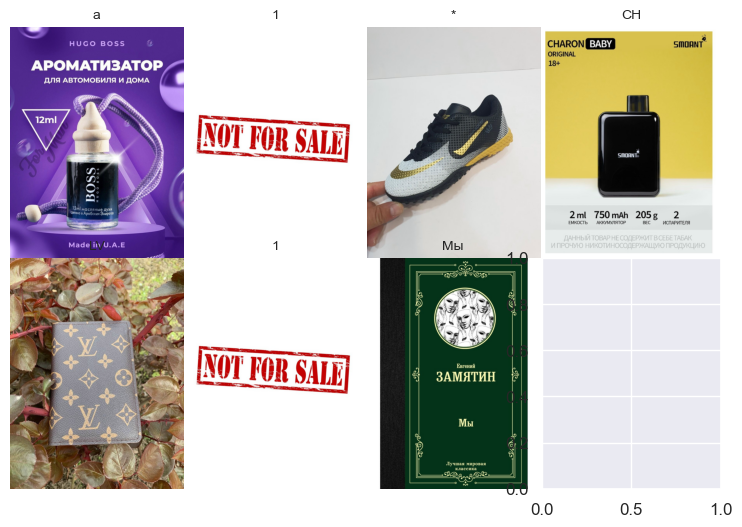

In [158]:
# посмотрим на изображения товаров с коротким заголовком
plot_images(path_to_zip, train[train.title.str.len() < 3].nm.apply(lambda x: str(x) + '.jpg'), 
            titles=train[train.title.str.len() < 3].title.values, cols=4, bgr_to_rgb=True)

Можно удалить из рассмотерния записи с заголовком '1'. Для остальных есть возможность расширить title с использованием, например, OCR, применить NER в описании, добавить информацию из характеристик или добавить в ручную (таким, мы конечно же, заниматься никогда не будем).

In [159]:
# удалим записи с заголовком короче двух символов
train = train[train.title.str.len() >= 2]

Для дальнейшего анализа частотностей слов и словосочетаний полезно будет провести лемматизацию заголовков и описаний. Также проведем поиск именованных сущностей, для чего будем использовать SpaCy. В следующей ячейке представлен код, который использовался для проведения лемматизации. Поскольку ноутбук часто перезапускался, эти данные были сохранены в файле train_lemmatized.parquet.

In [26]:
# %%time
# # в среднем 1 час

# проведем лемматизацию и NER
# normalizer = TextNormalizer()

# train[['title_lemmatized', 'ner_title']] = normalizer.transform(train.title, ner=True)
# train[['description_lemmatized', 'ner_description']] = normalizer.transform(train.description, ner=True)

# train[['nm', 'title_lemmatized', 'description_lemmatized', 'ner_title', 'ner_description']].to_parquet('train_lemmatized.parquet', index=False)

In [160]:
# загрузим данные с лемматизацией и NER
train = train.merge(pd.read_parquet('train_lemmatized.parquet'), on='nm', how='left')

In [28]:
num_desc = train.ner_description.apply(lambda x: x['LOC'] is None and x['ORG'] is None and x['PER'] is None).sum()
num_title = train.ner_title.apply(lambda x: x['LOC'] is None and x['ORG'] is None and x['PER'] is None).sum()

print(f'Число записей description, для которых нет данных NER: {num_desc} ({num_desc / len(train) * 100:.1f}%)')
print(f'Число записей title, для которых нет данных NER: {num_title} ({num_title / len(train) * 100:.1f}%)')

Число записей description, для которых нет данных NER: 35263 (35.5%)
Число записей title, для которых нет данных NER: 79524 (80.1%)


Как можно видеть, из заголовков редко удается выделить именованные сущности. Посмотрим, что нашел SpaCy из описаний.

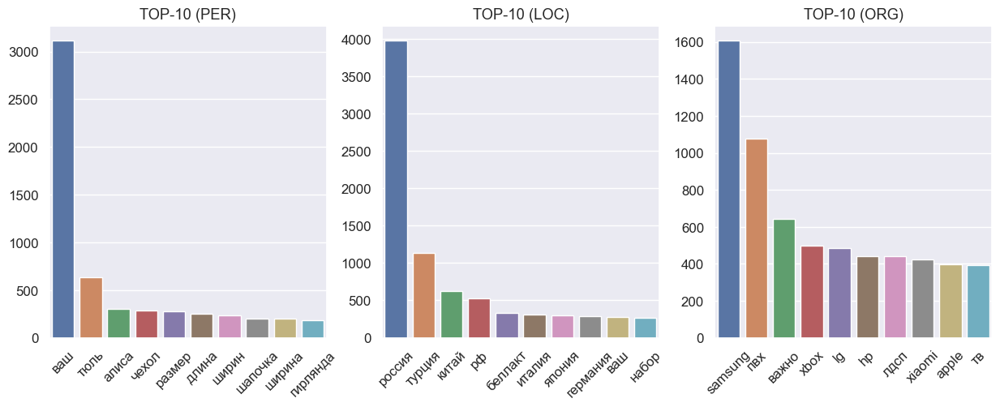

In [29]:
ner_counter = {
    'PER': Counter(),
    'LOC': Counter(),
    'ORG': Counter(),
}

for ner in train[train.ner_description != {}].ner_description.values:
    for k, v in ner.items():
        ner_counter[k].update(v)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))
axes = axes.flatten()

for i, (k, v) in enumerate(ner_counter.items()):
    most_common = ner_counter[k].most_common(10)
    sns.barplot(x=[x[0] for x in most_common], y=[x[1] for x in most_common], ax=axes[i])
    axes[i].set_title(f'TOP-10 ({k})')
    axes[i].set_xticks(range(10), labels=[x[0] for x in most_common], rotation=45)

Видно, что из тега `PER` можно получить информацию о типе товара, из `LOC` о стране-производителе, из `ORG` о бренде. Однако во всех случаях присутсвует много шумов. Например, в `ORG` к организациям еще добавились материалы (пвх, лдсп). Чтобы эти данные можно было использовать, необходимо создать списки из всех доступных брендов/стран/типов товара и при добавлении признака проверять, входит ли он в эти списки. Пока что не ясно, понадобится ли эти данные при обучении модели.

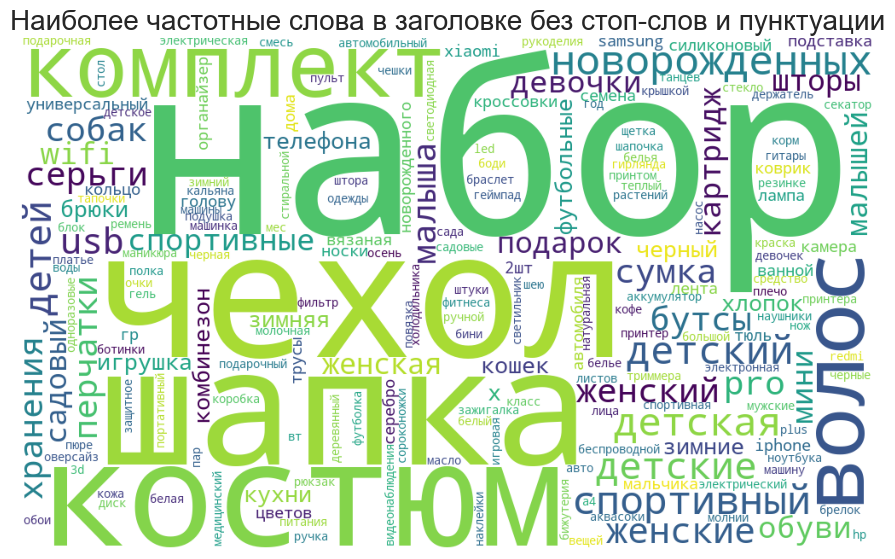

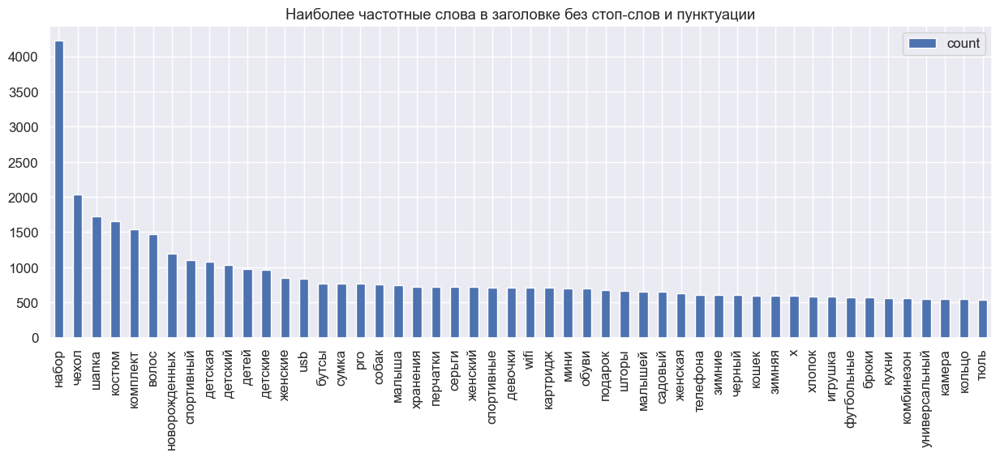

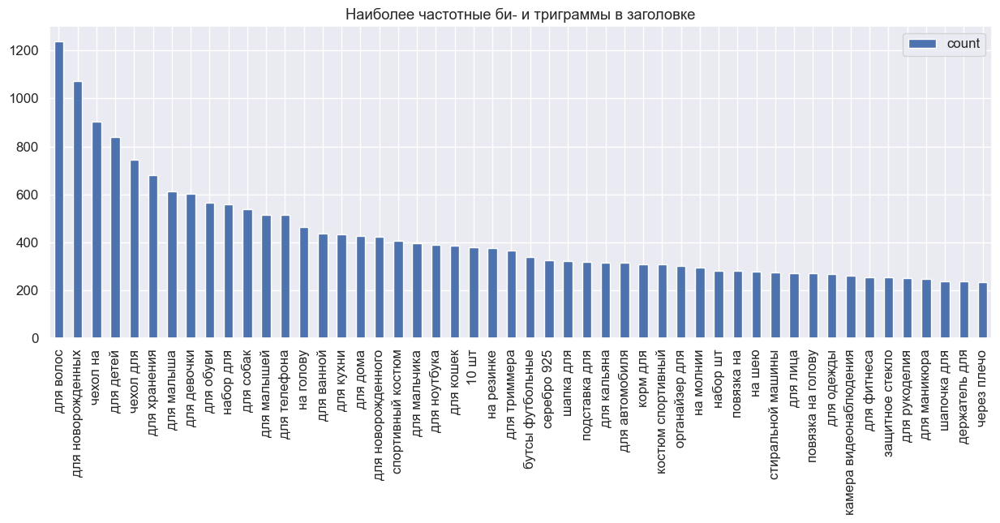

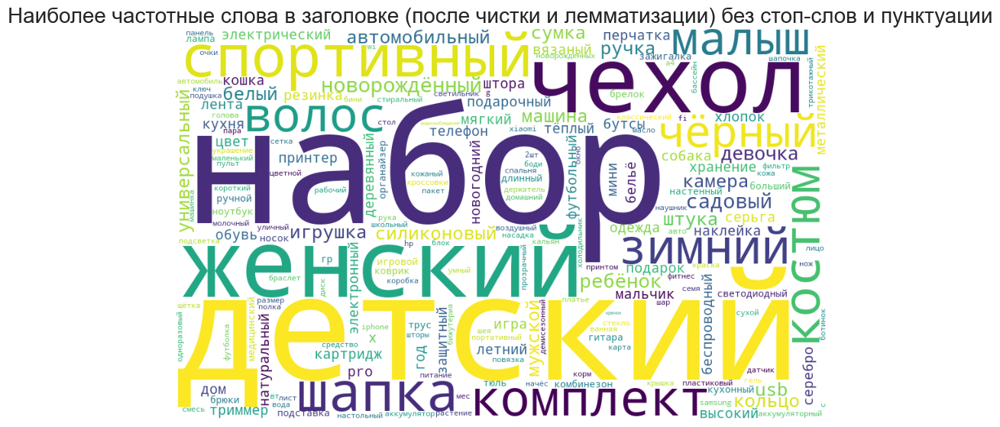

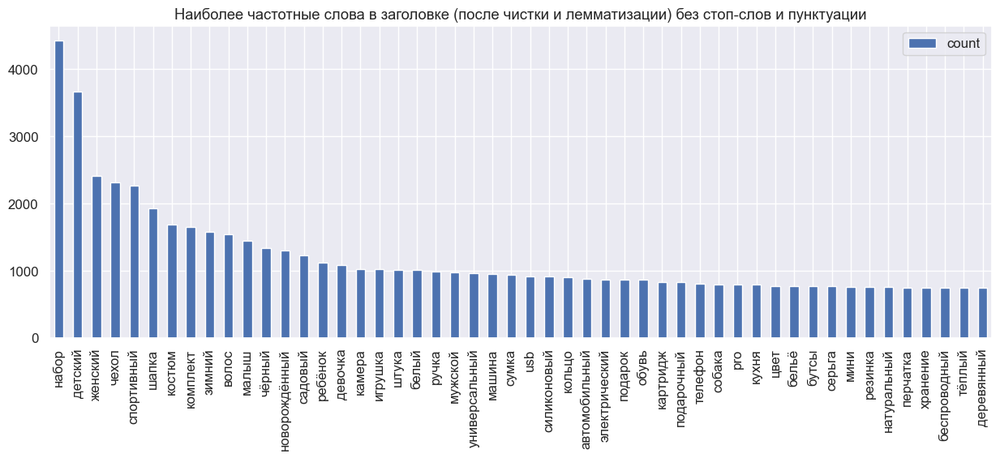

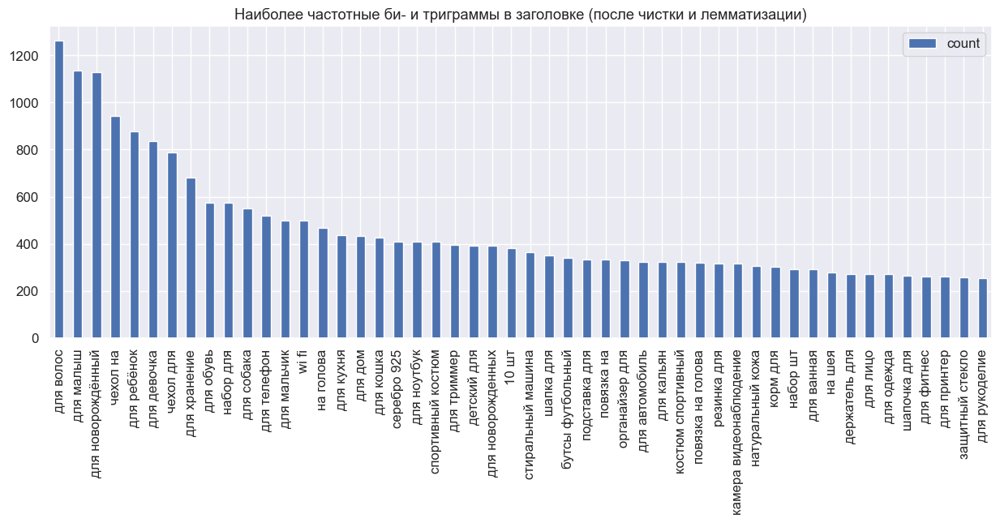

In [30]:
# посмотрим на встречаемость слов, би и триграм в заголовках
title_ngrams = show_freq_analysis(train, col_names=['title', 'title_lemmatized'], 
                                  titles=['заголовке', 'заголовке (после чистки и лемматизации)'])

- чаще всего в заголовке встречается предлог "для", что не удивительно, поскольку он сразу характеризует область применения товара. Также часто указывают значения характеристики размера/веса/объема с единицами измерения;
- встречается много наборов, спортивных товаров, чехлов, указывается сезонность товара и преднозначение по полу/возрасту (детский, женский, ребенок, мужской).

Возможно стоит использовать словосочетания `для <слово>` как признак. Однако видно, что в случае заголовков это малочастотный признак. Возможно удастся извлечь больше информации из описаний.

In [31]:
# посчитаем, сколько раз встречается словосочетания для <слово>
print('Число товаров со словосочетаниями "для <слово>" в заголовках:', len(re.findall(r'для [\w]+', ' '.join(train.title_lemmatized))))

# в случае описаний "для" для одного товара может встречаться много раз
# посчитаем наивно: если хоть раз встречалось "для", значит в описании указано для чего товар
print('Число товаров со словосочетаниями "для <слово>" в описаниях:', train.description_lemmatized.apply(lambda x: True if 'для' in x else False).sum())

Число товаров со словосочетаниями "для <слово>" в заголовках: 40587
Число товаров со словосочетаниями "для <слово>" в описаниях: 88418


Кажется, признак построенный на основе словосочетаний может быть дотстаточно полезным. С его помощью можно оценивать категории/подкатегории.

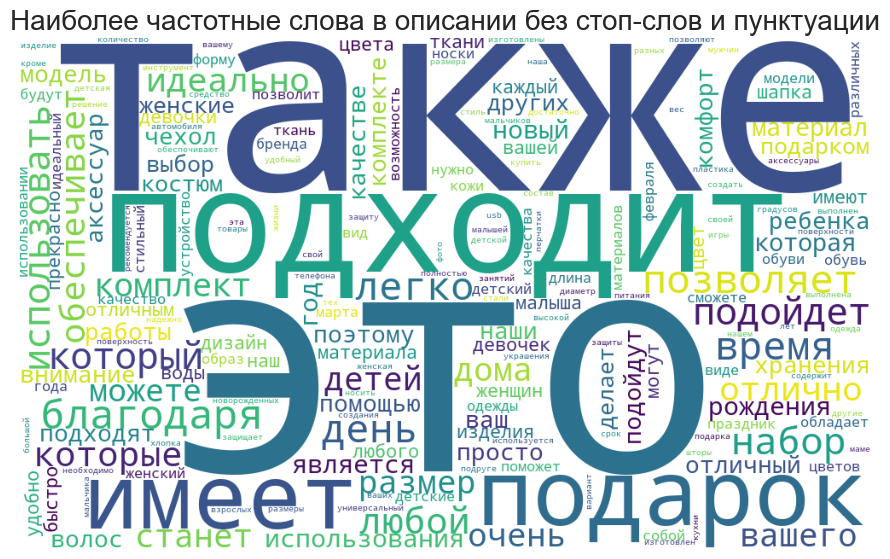

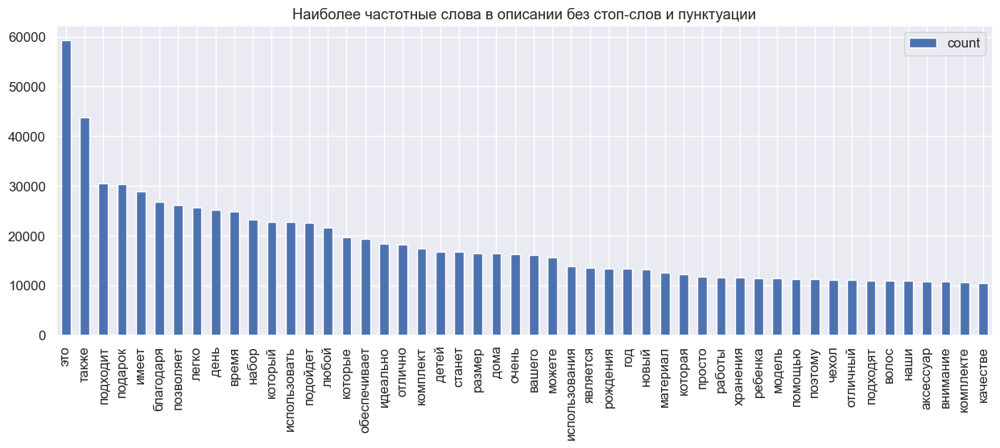

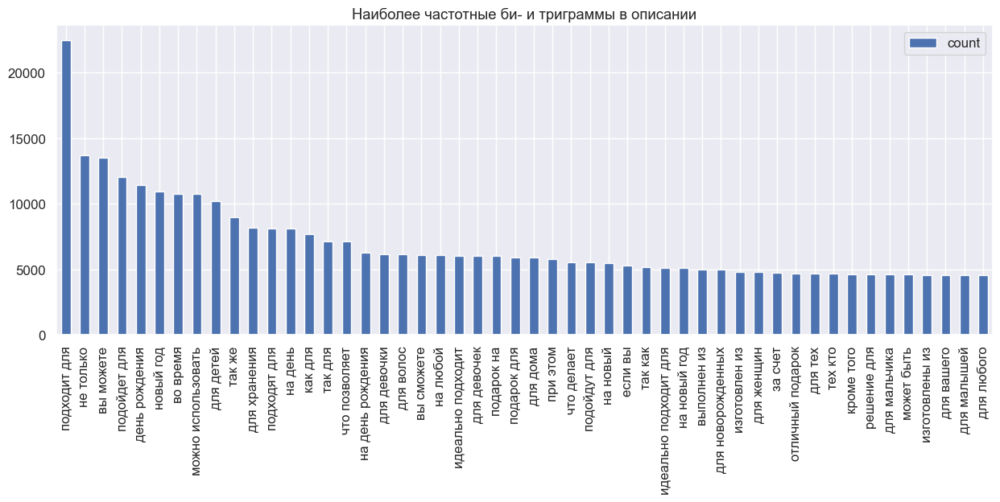

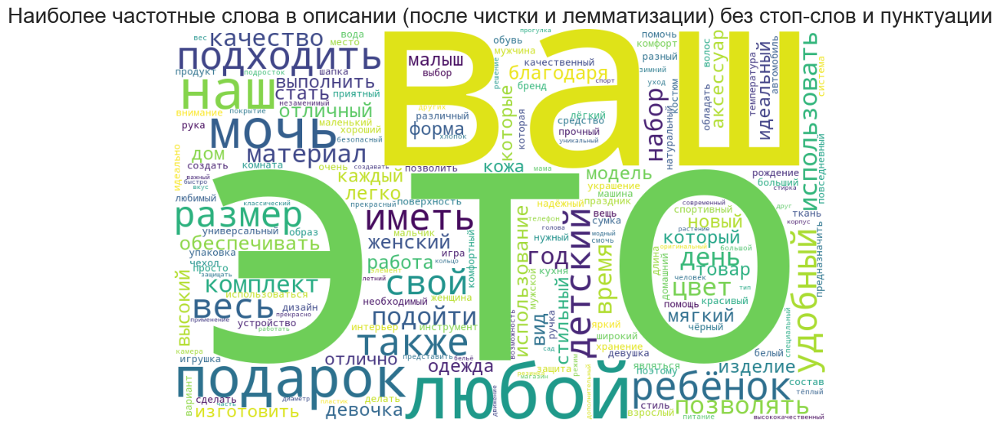

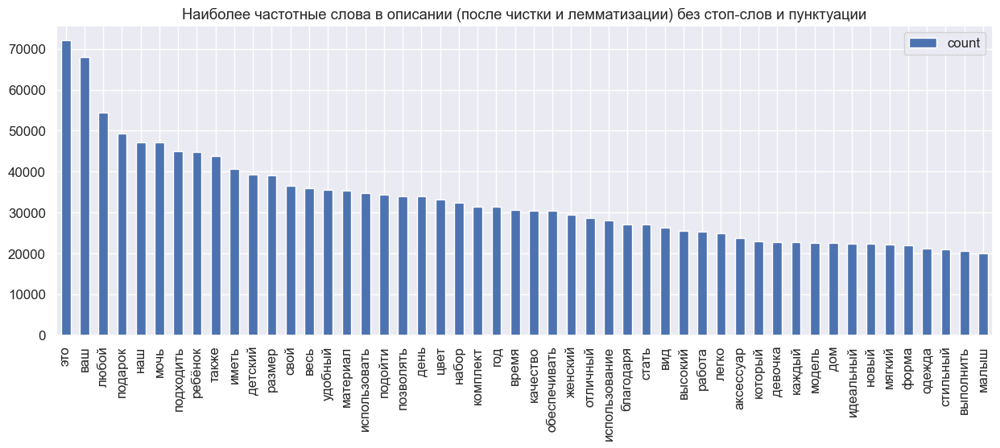

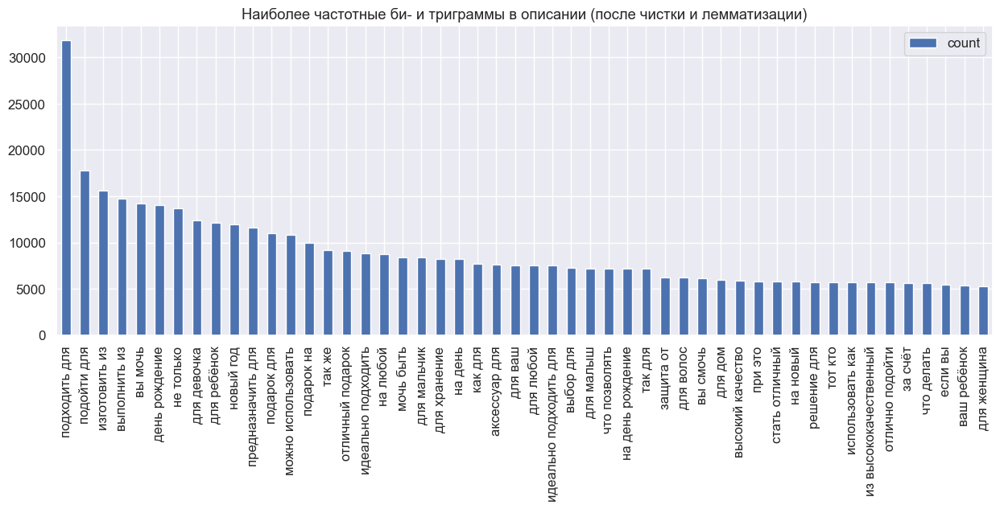

In [32]:
# проделаем всё то же самое для описаний
desc_ngrams = show_freq_analysis(train, col_names=['description', 'description_lemmatized'],
                                 titles=['описании', 'описании (после чистки и лемматизации)'])

В описаниях, помимо указания "для чего" товар предназначен, часто используют продающие слова про "отличный подарок на день рождения", "высокое качество", "идеально подходит" и т.п.. Такие слова можно будет удалять как "шумовые".

In [33]:
# добавим колонку, где будут все словосочетания "для <слово>" (без повторений) из лемматизированного описания
train['description_for'] = train.description_lemmatized.progress_apply(lambda x: ', '.join(set(re.findall(r'для ([\w]+)', str(x)))))
train.description_for.head(20)

  0%|          | 0/99308 [00:00<?, ?it/s]

0                                                      
1                                            малыш, ваш
2                          подросток, футбол, зал, игра
3                                         офис, телефон
4                                      ребёнок, занятие
5                                                      
6        подключение, мобильный, телефон, зарядка, весь
7                           мальчик, ваш, новорожденных
8     музыкальный, ваш, хранение, акустический, защи...
9                                           дом, летний
10                        девушка, домашний, беременный
11                    сохранность, чай, пакетик, чайный
12                                               защита
13                           хороший, пабг, любой, игра
14                                    охрана, помещение
15              нанесение, окраска, окрашивание, работа
16                                                     
17                      прогулка, плавание, отды

Полученные данные можно кодировать, например, при помощи TF-IDF и использовать в качестве признака. Либо, можно посмотреть какие подкатегории бывают (из test датасета), отфильтровать получаемые данные по вхождению в список таких подкатегорий и использовать полученные данные как таргет. Проверим эту гипотезу при переходе к анализу test датасета.

### Характеристики

Характеристики представляют собой набор двоичных строк. Чтобы с ними работать необходимо для начала декодировать их. Всего можно обнаружить два паттерна для характеристик, учтем это при составлении функции. Чтобы не захламлять ноутбук не будем выводить полностью данные строки.

In [34]:
# пример двух паттернов
train.characteristics.iloc[9:11]

9     b"[{'charcName': '\xd0\xa0\xd0\xb8\xd1\x81\xd1...
10    b'b\'b\\\'[{"charcName":"\\\\\\\\u0421\\\\\\\\...
Name: characteristics, dtype: object

In [164]:
# декодируем все характеристики
train['characteristics'] = train.characteristics.progress_apply(process_characteristics)

  0%|          | 0/99308 [00:00<?, ?it/s]

In [36]:
# посмотрим, имеются ли записи без характеристик
train[train.characteristics.str.len() == 0]

,nm,title,description,characteristics,title_lemmatized,description_lemmatized,ner_title,ner_description,description_for
23940,174825978,Для Собак 100г Печенье Говядина/Шпинат,В основе «Деревенских лакомств» лежат традиции...,[],Для собака 100 г печенье говядина шпинат,в основа деревенский лакомство лежать традиция...,"{'LOC': None, 'ORG': None, 'PER': ['собака', '...","{'LOC': None, 'ORG': ['деревенский лакомство']...","дрессура, собака"
26634,170714407,Светильник (ГЛН) МR-16 непов. 50Вт GU5.3 12В ш...,Светильник встраиваемый ST1 SN - замечательное...,[],светильник глн мr-16 непов 50вт gu5.3 12в штам...,светильник встраиваемый st1 sn замечательный р...,"{'LOC': None, 'ORG': None, 'PER': ['сатин']}","{'LOC': None, 'ORG': ['эра'], 'PER': None}","установка, помещение, любой, создание"
44098,177003115,Варочная панель THOMSON HC20-4E03,,[],варочный панель thomson hc20 4e03,,"{'LOC': None, 'ORG': None, 'PER': None}","{'LOC': None, 'ORG': None, 'PER': None}",
64672,15292513,Кресло мешок Груша XXL Оксфорд Принт,Детское Кресло мешок груша с ярким принтом укр...,[],кресло мешок груша xxl оксфорд принт,детский кресло мешок груша с яркий принтом укр...,"{'LOC': None, 'ORG': None, 'PER': ['груша xxl ...","{'LOC': None, 'ORG': None, 'PER': None}",
97662,160823240,Влажный корм для кошек ягненок и курица в желе...,Лучше вкуснятины может быть только Двойная вку...,[],влажный корм для кошка ягненок и курица в желе...,Лучше вкуснятины мочь быть только двойной вкус...,"{'LOC': None, 'ORG': None, 'PER': None}","{'LOC': None, 'ORG': ['purina', 'felix', 'feli...","взрослый, здоровье"


In [37]:
print('Все возможные названия полей характеристик и их типы данных:')
possible_char_fields = set().union(*train.characteristics.apply(lambda x: set((k, type(v)) for y in x for k, v in y.items())))

# определяем возможные типы данных для поля, исключая None
all_char_fields = defaultdict(list)
for k, v in possible_char_fields:
    if v is not type(None):
        all_char_fields[k].append(v)

for k, v in all_char_fields.items():
    print(f'{k:>15}: {v}')

Все возможные названия полей характеристик и их типы данных:
     isUnifying: [<class 'bool'>]
      charcName: [<class 'str'>]
      groupName: [<class 'str'>]
      groupSort: [<class 'float'>, <class 'int'>]
    charcValues: [<class 'numpy.ndarray'>, <class 'list'>]
          value: [<class 'float'>, <class 'int'>]
      charcType: [<class 'float'>, <class 'int'>]
      charcSort: [<class 'float'>, <class 'int'>]
     valueNames: [<class 'list'>, <class 'numpy.ndarray'>]
     visibility: [<class 'bool'>]
       unitName: [<class 'str'>]
     isVariable: [<class 'bool'>]


In [38]:
# посчитаем как часто встречаются различные значения для указанных выше полей
char_fields_count= {field[0]: Counter() for field in possible_char_fields}

for char_list in tqdm(train.characteristics.values):
    for char in char_list:
        for field, value in char.items():
            # не будем учитывать пустые значения
            if value is None:
                continue
            if isinstance(value, np.ndarray) or isinstance(value, list):
                char_fields_count[field].update(value)
            else:
                if isinstance(value, str):
                    value = value.lower()
                char_fields_count[field].update([value])

  0%|          | 0/99308 [00:00<?, ?it/s]

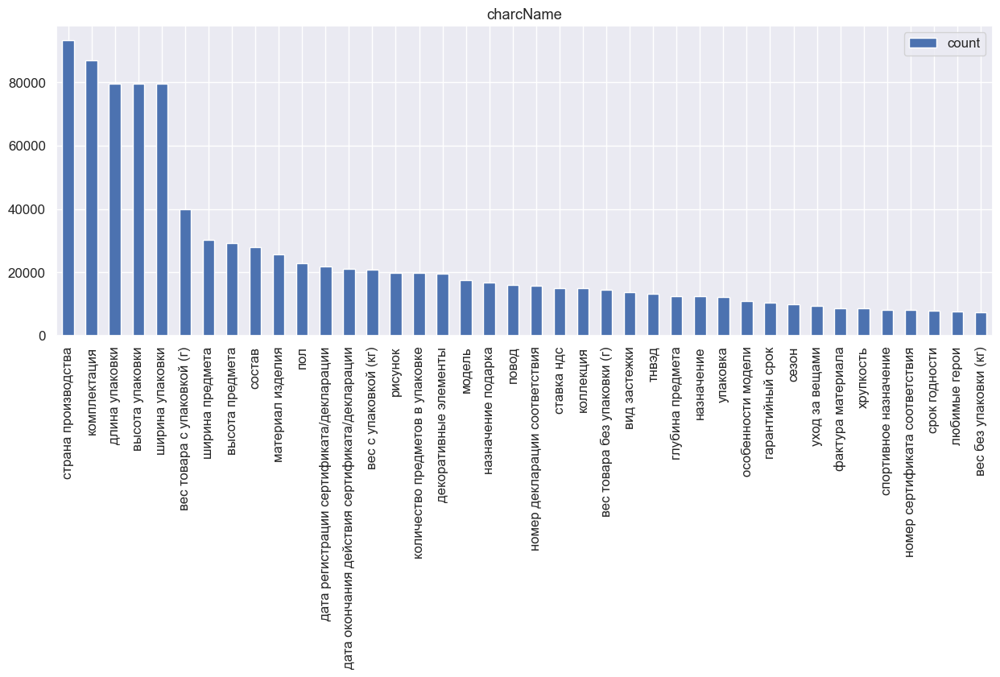

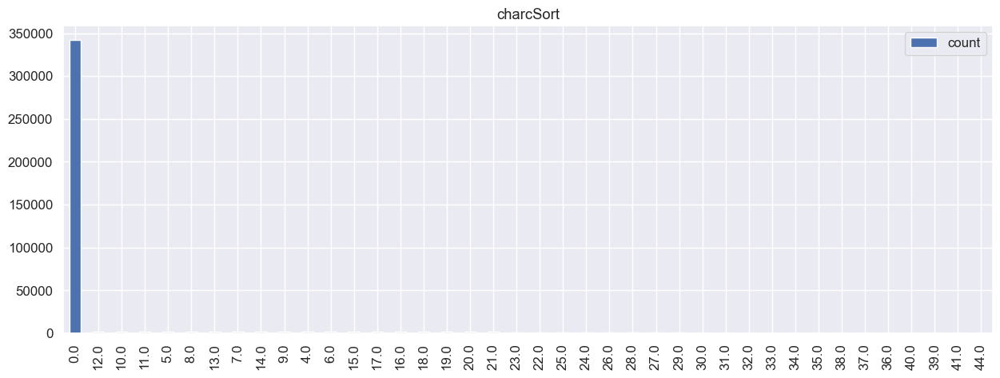

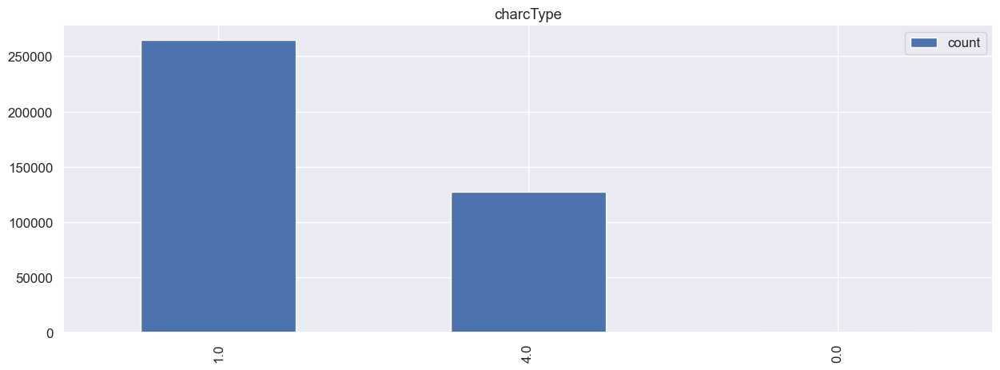

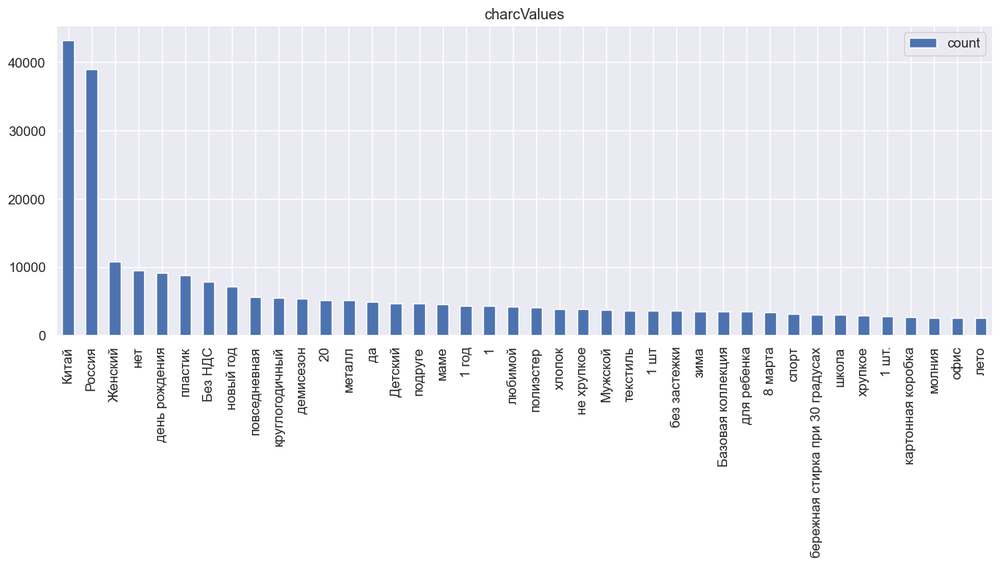

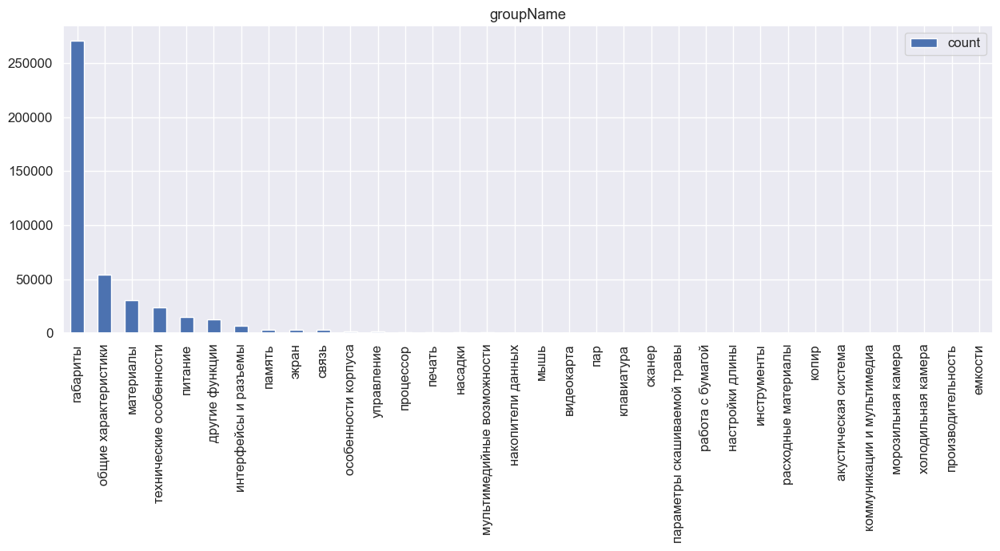

...

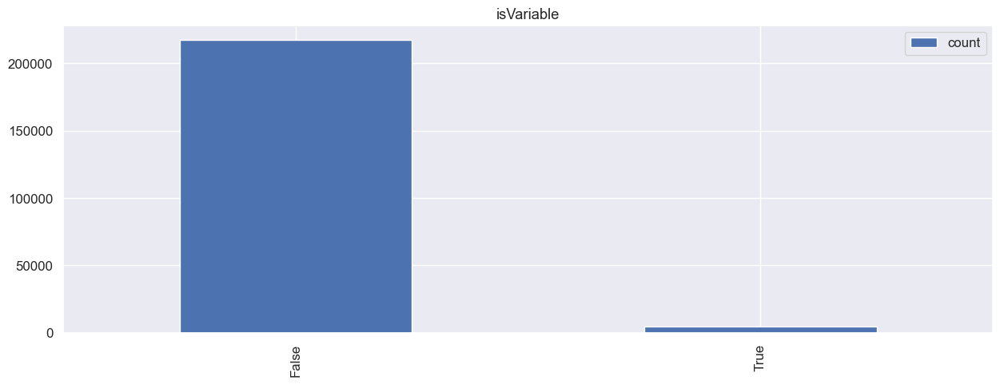

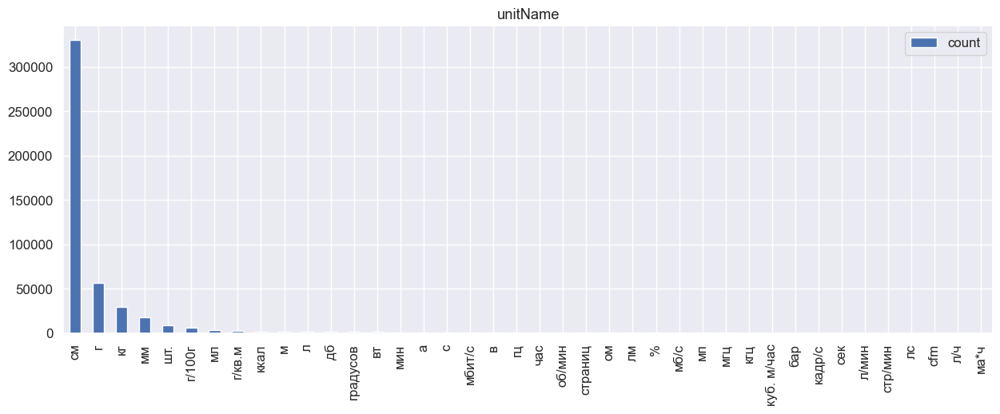

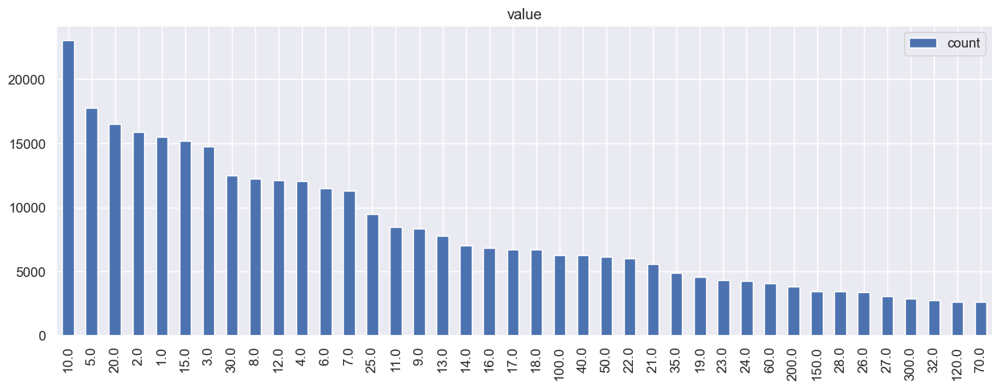

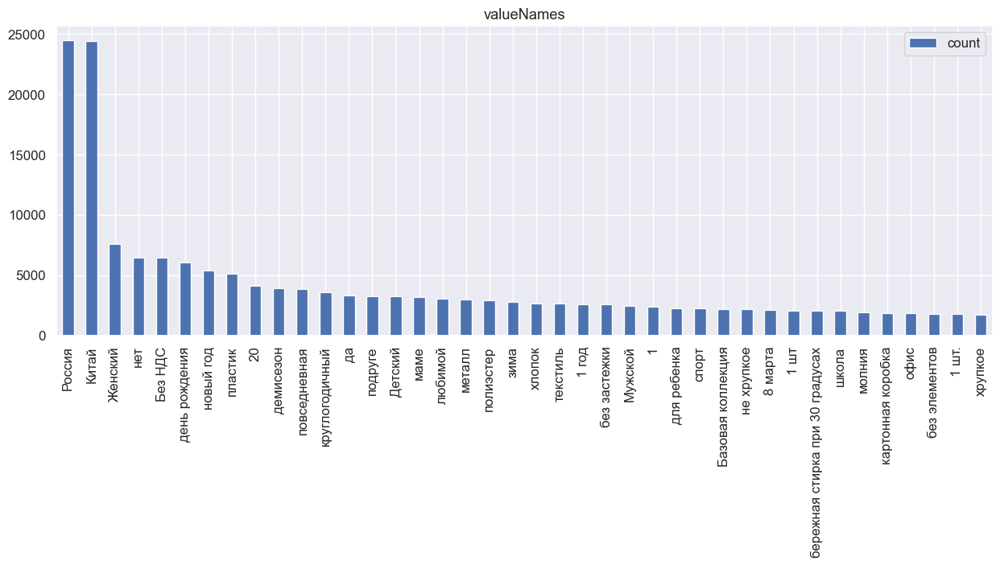

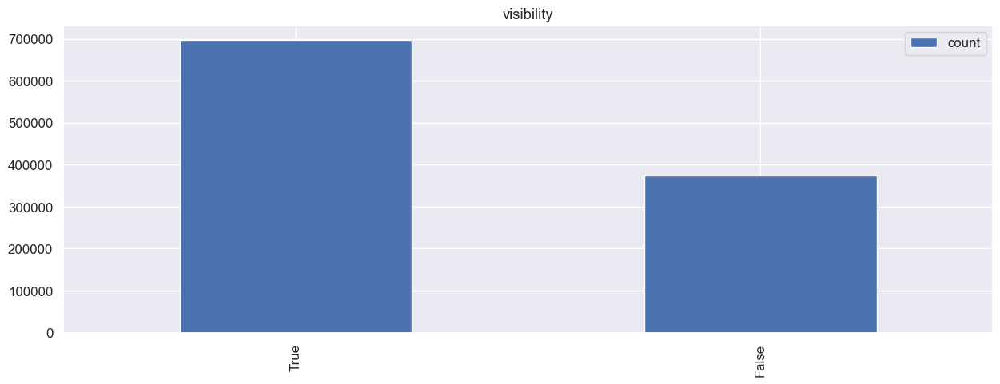

In [39]:
for char_field in sorted(char_fields_count):
    plot_freqs(char_fields_count[char_field].most_common(40), title=char_field)

- в качестве характеристики (charcName) чаще всего указывают страну производства, параметры упаковки/товара (длина, ширина, высота, вес), состав, для кого предназначен товар (пол), информацию о сертификатах и НДС;
- value представляет собой численное значение характеристики;
- строковые описания характеристики представляют в charcValues и valueNames, чаще всего представлены товары из Китая или России, для женщин, на новый год или день рождения, часто указывают сезонность;
- в groupName указывается информация, похожая на категорию или подкатегорию характеристики;
- в visibility и isUnifying указывается только True или False, пока что не понятно что именно они значат;
- unitName указывает на размерность представленных в value данных.

In [40]:
# посмотрим, для каких характеристик чаще ставят visible=True, для каких - False и где не указано
visibility = {True: Counter(), False: Counter(), None: Counter()}

# то же для isUnifying
unifying = {True: Counter(), False: Counter(), None: Counter()}

for char_list in train.characteristics.values:
    for char in char_list:
        if 'visibility' not in char:
            visibility[None].update([char['charcName']])
        else:
            visibility[char['visibility']].update([char['charcName']])
            
        if 'isUnifying' not in char:
            unifying[None].update([char['charcName']])
        else:
            unifying[char['isUnifying']].update([char['charcName']])

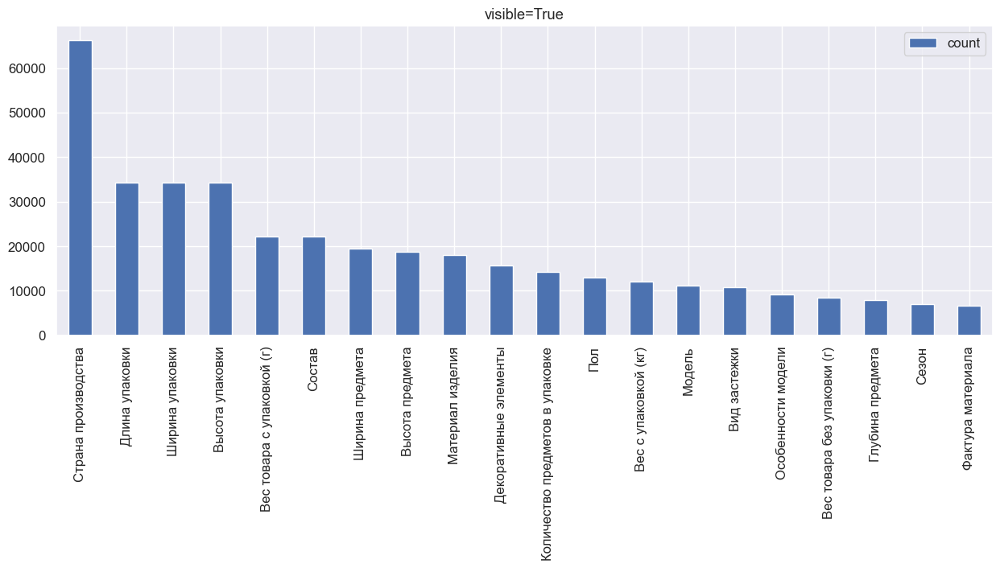

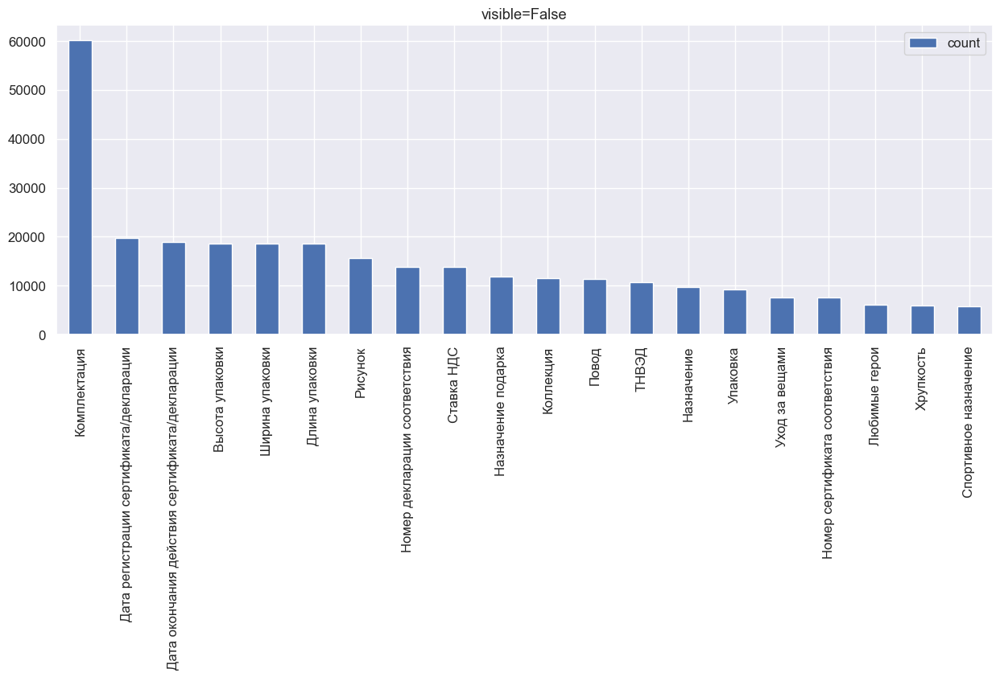

In [41]:
for val in [True, False]:
    plot_freqs(visibility[val].most_common(20), title=f'visible={val}')

- чаще всего visible=True указывается для характеристик, содержащих общую информацию о товаре и упаковке;
- visible=False указывается для характеристик, содержащих информацию о сертификатах, декларациях, об НДС и т.п..

Судя по всему, visible определяет, будет ли видна указанная характеристика покупателю или нет. Данное поле не выглядит полезным.

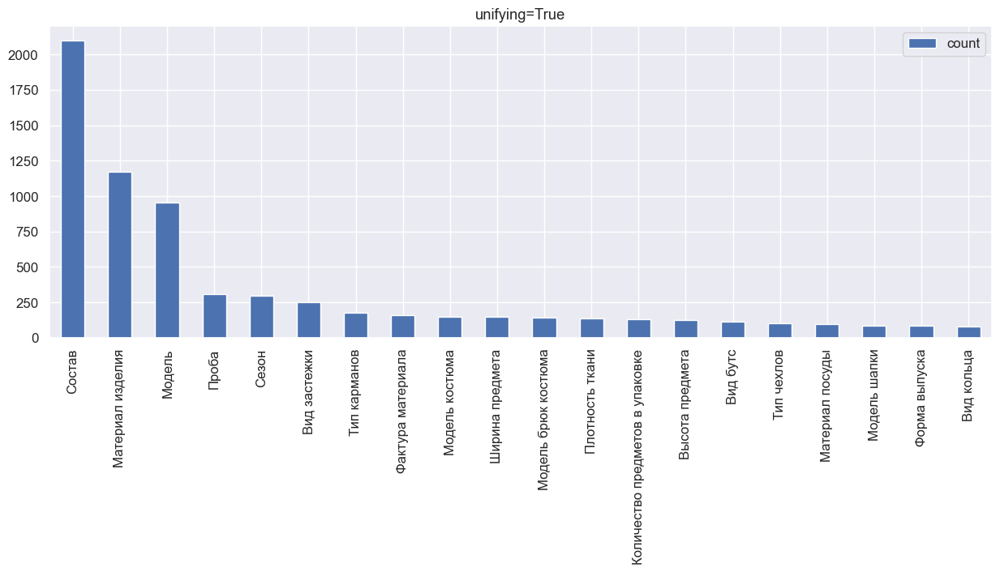

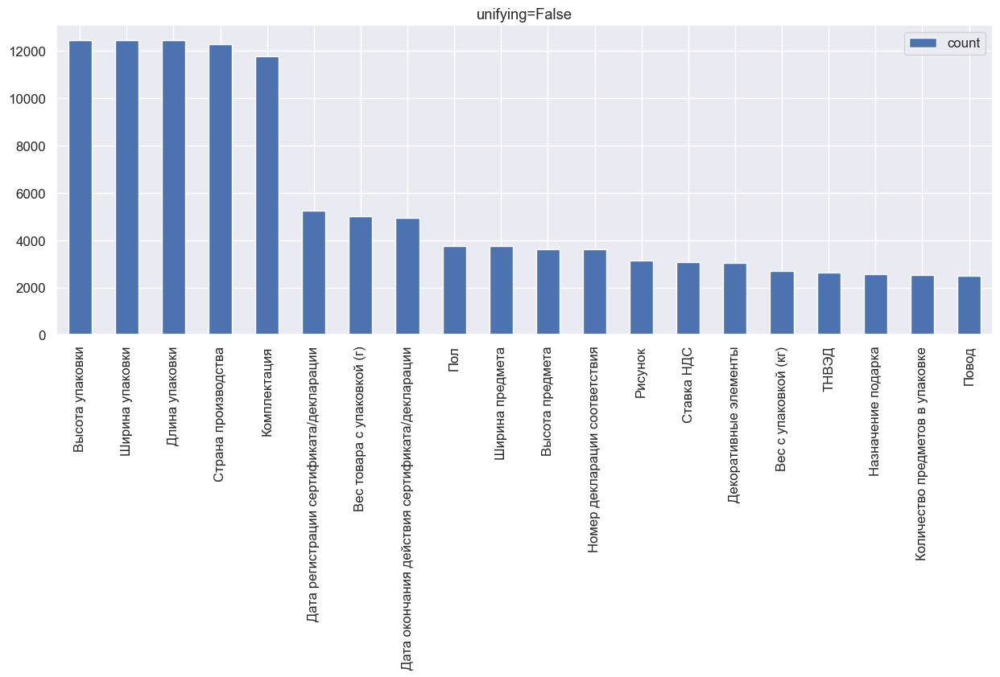

In [42]:
for val in [True, False]:
    plot_freqs(unifying[val].most_common(20), title=f'unifying={val}')

C `isUnifying` достаточно сложно выделить какую-либо полезную информацию.

In [202]:
def get_characteristic(char_list: list[dict], 
                       char_names: list[str]) -> float|list[float]:
    """
    Извлечение значений характеристик из списка char_list, которые обладают названиями char_names.
    """
    
    res = [np.nan] * len(char_names)
        
    for char in char_list:
        if char['charcName'] in char_names:

            if 'value' in char and char['value'] is not None:
                if isinstance(char['value'], str):
                    char['value'] = float(char['value'].replace(',', '.'))

                res[char_names.index(char['charcName'])] = char['value']

            if 'charcValues' in char and char['charcValues'] is not None:
                if len(char['charcValues']) == 1:
                    res[char_names.index(char['charcName'])] = char['charcValues'][0]
                else:
                    res[char_names.index(char['charcName'])] = list(char['charcValues'])
                    
    return res

In [203]:
df = train[['characteristics']].copy()

In [204]:
pd.DataFrame(data=df.characteristics.iloc[:10].progress_apply(lambda x: get_characteristic(x, [t[0] for t in interesting_chars])).to_list(),
             columns=[t[0] for t in interesting_chars])

  0%|          | 0/10 [00:00<?, ?it/s]

,Страна производства,Пол,Возрастные ограничения,Вес с упаковкой (кг),Длина упаковки,Ширина упаковки,Высота упаковки,Глубина предмета,Ширина предмета,Высота предмета,Рисунок,Сезон,Материал изделия,Срок годности,Хрупкость
0,Россия,NaN,18+,NaN,27.0,21.0,5.0,7.0,22.0,27.0,NaN,NaN,NaN,NaN,NaN
1,Китай,NaN,NaN,0.46,NaN,NaN,NaN,NaN,13.0,15.0,NaN,NaN,NaN,NaN,NaN
2,Китай,Детский,NaN,NaN,15.0,10.0,22.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Китай,Женский,NaN,NaN,15.0,28.0,35.0,12.0,24.5,31.0,NaN,NaN,NaN,NaN,NaN
4,Россия,Девочки,NaN,NaN,30.0,17.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Китай,NaN,NaN,NaN,12.0,5.0,3.0,3.3,10.5,10.5,NaN,NaN,NaN,NaN,NaN
6,Китай,NaN,NaN,NaN,4.0,10.0,13.0,2.7,6.6,10.0,NaN,NaN,NaN,NaN,хрупкое
7,Китай,Детский,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Китай,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Россия,Женский,NaN,NaN,30.0,26.0,1.0,NaN,NaN,NaN,полоска,NaN,NaN,NaN,NaN


In [44]:
# выберем наиболее частотные характеристики и несколько потенциально полезных
# объединим характеристики 'Вес с упаковкой (кг)' и 'Вес товара с упаковкой (г)'
interesting_chars = [['Страна производства'], ['Пол'], ['Возрастные ограничения'], ['Вес с упаковкой (кг)', 'Вес товара с упаковкой (г)'], 
                     ['Длина упаковки'], ['Ширина упаковки'], ['Высота упаковки'], ['Глубина предмета'], ['Ширина предмета'], ['Высота предмета'], ['Рисунок'],
                     ['Сезон'], ['Материал изделия'], ['Срок годности'], ['Хрупкость']]

new_names = ['country', 'sex', 'age_restrictions', 'pack_weight', 'pack_length', 'pack_width', 'pack_height', 'item_length', 'item_width', 'item_height', 'image',
             'season', 'material', 'expiry_date', 'fragility']
characteristics = pd.DataFrame(train.nm)

for i, char_names in enumerate(interesting_chars):
    characteristics[new_names[i]] = train.characteristics.apply(lambda x: get_characteristic(x, char_names))

In [45]:
# возьмем первое значение, где представлен список нескольких ограничений
characteristics['age_restrictions'] = characteristics.age_restrictions.apply(lambda x: x[0] if isinstance(x, list) else x)

# в колонке sex встречает по одному значение 'детский' и Women, обработаем их
characteristics['sex'] = characteristics.sex.replace(['детский', 'Women'], ['Детский', 'Женский'])

#### Страна производства

Всего записей с характеристикой "страна производства": 93191 (93.8%)


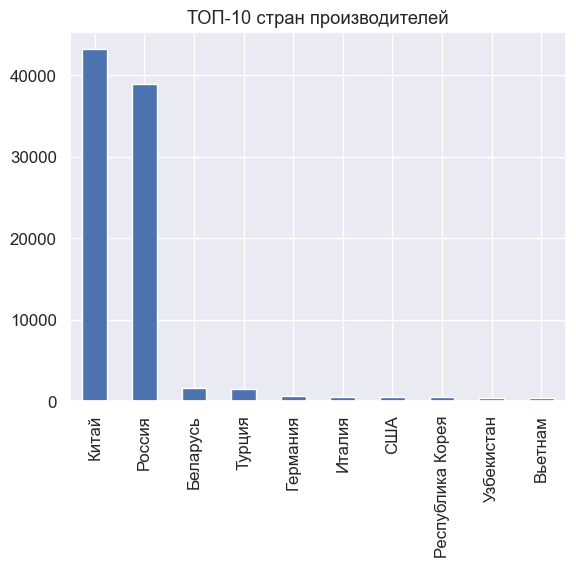

In [46]:
# выведем ТОП-10 стран производителей
country_freqs = characteristics.country.value_counts()
print(f'Всего записей с характеристикой "страна производства": {country_freqs.sum()} ({country_freqs.sum() / len(train) * 100:.1f}%)')

country_freqs.head(10).plot(kind='bar')
plt.title('ТОП-10 стран производителей')
plt.show();

Видно, что с большим отрывом лидируют Россия и Китай. Имеет смысл все остальные страны объединить в одну категорию.

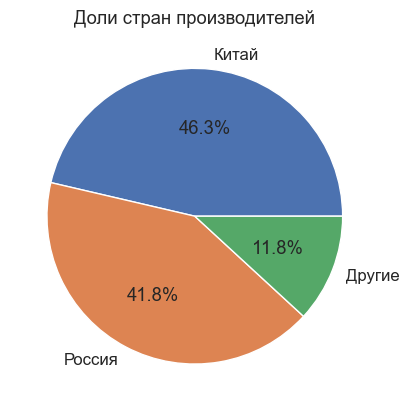

In [47]:
characteristics['country'] = characteristics.country.replace(country_freqs.index[2:], 'Другие')

country_freqs = characteristics.country.value_counts()
plot_pie(country_freqs.values, 'Доли стран производителей', country_freqs.index, '%1.1f%%')
plt.show();

Поскольку характеристика часто указывается, можно попробовать ее использовать как фичу, или как таргет.

#### Пол

Доля записей с характеристикой пола: 22.9%


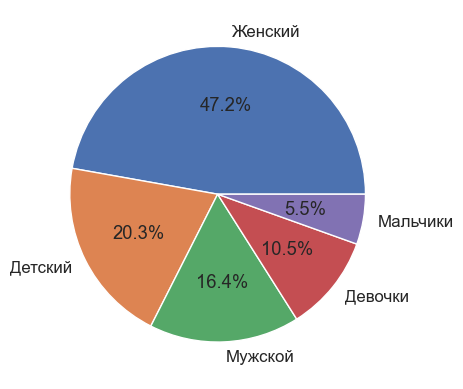

In [48]:
sex_freqs = characteristics.sex.value_counts()
print(f'Доля записей с характеристикой пола: {sex_freqs.sum() / len(train) * 100:.1f}%')
plot_pie(sex_freqs.values, None, sex_freqs.index, '%1.1f%%')

Характеристика "Пол" указана для 23% записей. Помимо "женский" и "мужской" сюда также входит "детский", "девочки" и "мальчики". Ее можно будет использовать как таргет, после дозаполнения информацией из описаний (поиск по ключевым словам), и определением оставшихся пропусков как 'для всех'. Таргет будет несбалансированным.

#### Возрастные ограничения

In [49]:
# посмотрим какие возрастные ограничения указывают
characteristics.age_restrictions.unique()

array(['18+', None, '3+', '8+', '12+', '10+', 'Нет ограничений', '6+',
       '16+', '5+', '4+', '+1мес', '0+', '6 мес +', '2+', 'от 3 +',
       '0 М +', '7+',
       'Для детей, для малышей, для подростков, для мальчика, для девочки',
       '14+', '16 лет', 'для малышей от трех месяцев', '1-3 лет',
       'Без возврастных ограниченийдя', 'нет', '3 +', '1+', '+5',
       '3 + лет', '+ 4 мес', '18 лет', 'для детей и взрослых', '+10',
       '1 год +', '+6', '+6мес', '+3', 'Без ограничений',
       'игрушки 0+, игрушки 1+', '+1 мес', '11+', 'для взрослых', '18 +',
       'для малышей', 'от 3 лет', 'от 3 месяцев', 'для детей',
       'для подростков', 'Без возврастных ограничений', '+4мес',
       '5+, 6, 7, 8. 9, 10', 'Для взрослых и детей старше 7-ми лет',
       '+ 6 мес', '1,5+', '45+', '6 +', '1+,2+,3+,4+,5+,6+,7+,8+', '8',
       'для всех возрастов', '0 +', 'без возрастных ограничений',
       'от 6 месяцев', '5+ лет', 'Новый год и Рождество', '16 +',
       'для малышей под прис

Мы наткнулись на целый зоопарк. Интересно, что иногда указывают значения более 18+, даже 100+. Попробуем всё это схлопнуть к следующим значениям:
- для малышей;
- для детей;
- для подростков;
- для взрослых;
- без ограничений.

In [50]:
def get_age_restrictions(ar):
    if ar is None:
        return 'не указано'
    
    ar = ar.lower()
    
    if re.findall(r'без|для всех|любо[йг]', ar):
        return 'без ограничений'
    
    if re.findall(r'мес|годик|рожден|малыш|реб[её]н', ar):
        return 'для малышей'
    
    nums = sorted(re.findall('\d+', ar))
    
    if nums:
        num = int(nums[0])
        if num >= 18:
            return 'для взрослых'
        elif 12 <= num < 18:
            return 'для подростков'
        elif 3 <= num < 12:
            return 'для детей'
        else:
            return 'для малышей'
        
    if re.findall(r'дет[ямскей]{2}|школ|девоч|мальчик', ar):
        return 'для детей'
    
    if re.findall(r'мужчин|женщин|взросл', ar):
        return 'для взрослых'
    
    if re.findall(r'подрост', ar):
        return 'для подростков'
        
    return 'без ограничений'

characteristics['age_restrictions'] = characteristics.age_restrictions.apply(get_age_restrictions)

Число записей с указанием "для взрослых": 333 (0.3%)
Число записей для которых "не указано" ограничение: 94877 (95.5%)


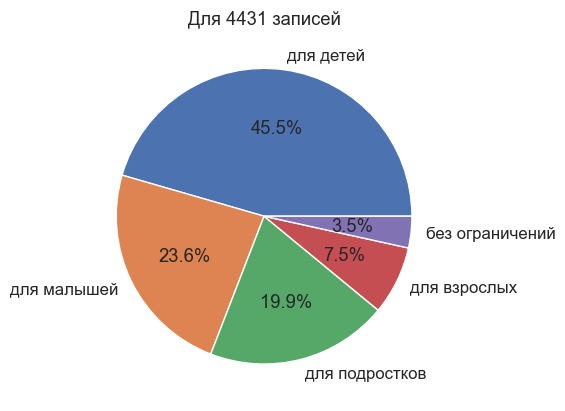

In [51]:
adult = characteristics.age_restrictions.value_counts()['для взрослых']
not_indicated = characteristics.age_restrictions.value_counts()['не указано']

print(f'Число записей с указанием "для взрослых": {adult} ({adult / len(train) * 100:.1f}%)')
print(f'Число записей для которых "не указано" ограничение: {not_indicated} ({not_indicated / len(train) * 100:.1f}%)')

freqs = characteristics.age_restrictions.value_counts().drop('не указано')
plot_pie(freqs.values, f'Для {freqs.sum()} записей', freqs.index, '%1.1f%%')
plt.show();

Отдельно только из этой характеристики вычленить много полезной информации не получится. Необходимо использовать также информацию из описаний.

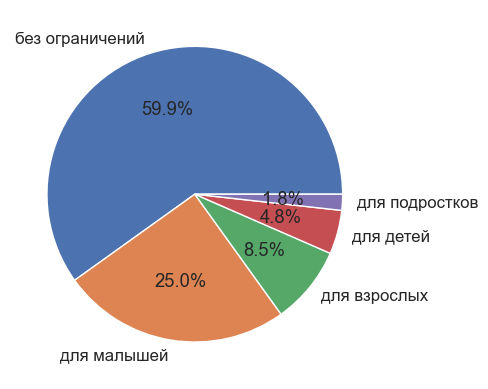

In [52]:
# посмотрим как сработает написанная функция на лемматизированных описаниях
res = train.description_lemmatized.apply(get_age_restrictions)

plot_pie(res.value_counts().values, None, res.value_counts().index, '%1.1f%%')

Необходимо будет еще поработать на данной функцией, но вычленение данной информации из описаний представляется возможным.

#### Размеры упаковок и товаров

In [53]:
# обрабатываем возможные ошибки, связанные с неверным указанием десятичных разделителей
for param in ['pack_weight', 'pack_length', 'pack_width', 'pack_height', 'item_length', 'item_width', 'item_height']:
    characteristics[param] = characteristics[param].dropna().apply(lambda x: float(str(x).replace(',', '.'))).astype(float)

In [54]:
characteristics.describe()

,nm,pack_weight,pack_length,pack_width,pack_height,item_length,item_width,item_height
count,9.930800e+04,59378.000000,79578.000000,79563.000000,79568.000000,12391.000000,30191.000000,29176.000000
mean,1.050657e+08,1196.508355,20.417747,17.025563,12.485877,16.771684,31.831218,34.195761
std,5.398944e+07,6841.122611,16.618274,12.371053,12.684432,93.331323,69.878803,68.110082
min,2.918080e+05,0.010000,0.100000,0.300000,0.050000,0.010000,0.010000,0.010000
25%,5.884439e+07,90.000000,9.000000,9.000000,4.000000,3.000000,6.700000,7.000000
50%,1.130502e+08,250.000000,17.000000,14.000000,9.000000,9.000000,13.900000,15.000000
75%,1.524807e+08,790.000000,28.000000,22.000000,17.000000,21.000000,30.000000,30.000000
max,1.968987e+08,600000.000000,200.000000,135.000000,210.000000,10000.000000,5000.000000,5300.000000


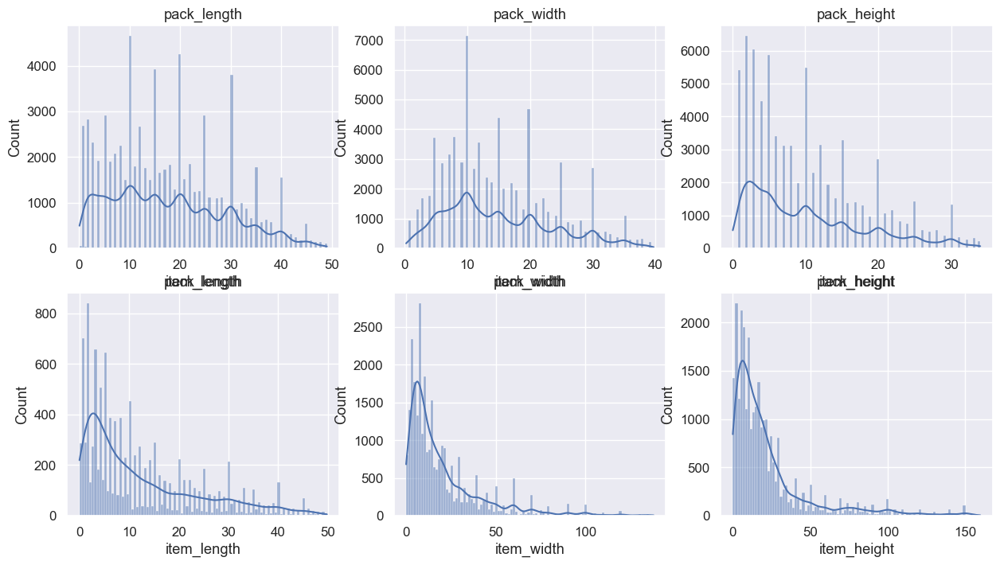

In [55]:
fig, ax = plt.subplots(2, 3, figsize=(15, 8))
ax = ax.flatten()

for i, param in enumerate(['pack_length', 'pack_width', 'pack_height', 'item_length', 'item_width', 'item_height']):
    df = characteristics[characteristics[param] < characteristics[param].quantile(0.95)][[param]]
    sns.histplot(data=df, x=param, ax=ax[i], kde=True, bins=100)
    ax[i].set_title(param)

plt.show();

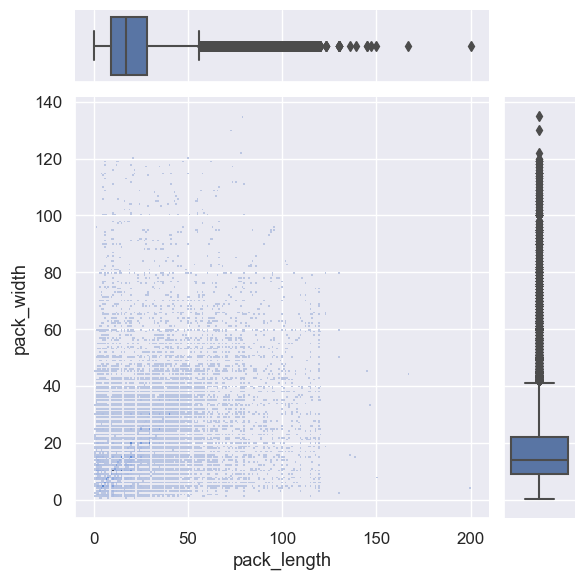

In [56]:
g = sns.JointGrid(data=characteristics, x='pack_length', y='pack_width')
g.plot_joint(sns.histplot)
g.plot_marginals(sns.boxplot);

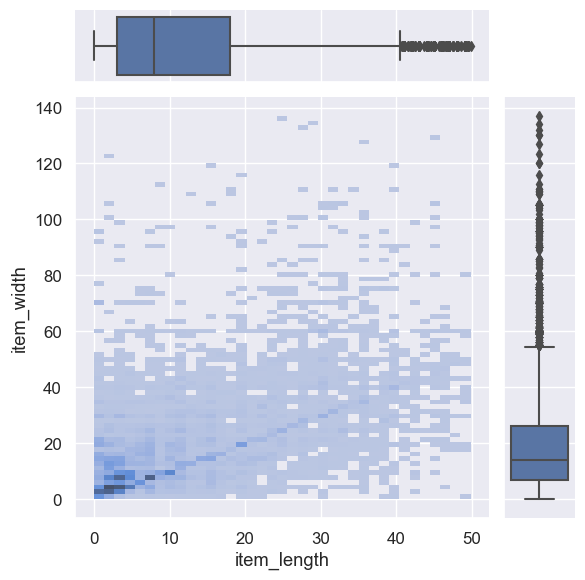

In [57]:
g = sns.JointGrid(data=characteristics[(characteristics.item_length < characteristics.item_length.quantile(0.95)) & 
                                       (characteristics.item_width < characteristics.item_width.quantile(0.95))], x='item_length', y='item_width')
g.plot_joint(sns.histplot)
g.plot_marginals(sns.boxplot);

Значения длины/ширины/высоты упаковок принимают конкретные значения, что скорее всего связано с их унификацией и типовыми размерами. В свою очередь значения размеров самих товаров распределены более непрерывно, однако имеются "всплески" на "круглых" значениях (например 20, 25, 30 и т.п.). Скорее всего продавцы округляют размеры при заполнении информации о товаре.

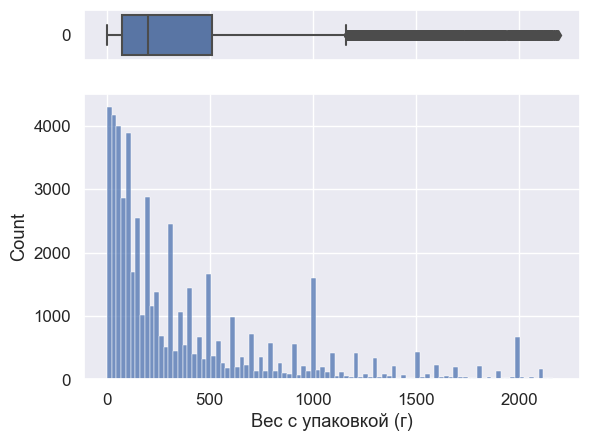

In [58]:
# у параметра 'pack_weight' имеются большие выбросы, поэтому для построения возьмем данные, которые имеют значение меньше 90-го квантиля
df = characteristics[(characteristics.pack_weight < characteristics.pack_weight.quantile(0.9))]

# создадим график, на котором будут и ящик-с-усами и гистограмма
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)})
 
sns.boxplot(df["pack_weight"], orient="h", ax=ax_box)
sns.histplot(data=df, x="pack_weight", ax=ax_hist)
 
ax_box.set(xlabel='')
ax_hist.set(xlabel='Вес с упаковкой (г)')
plt.show()

Поскольку достаточно часто указываются размеры упаковок и вес товара, данные характеристики можно будет использовать в качестве признаков.

#### Рисунок

Посмотрим как соотносится характеристика "image", в которой присутствует описание картинки, и сама картинка.

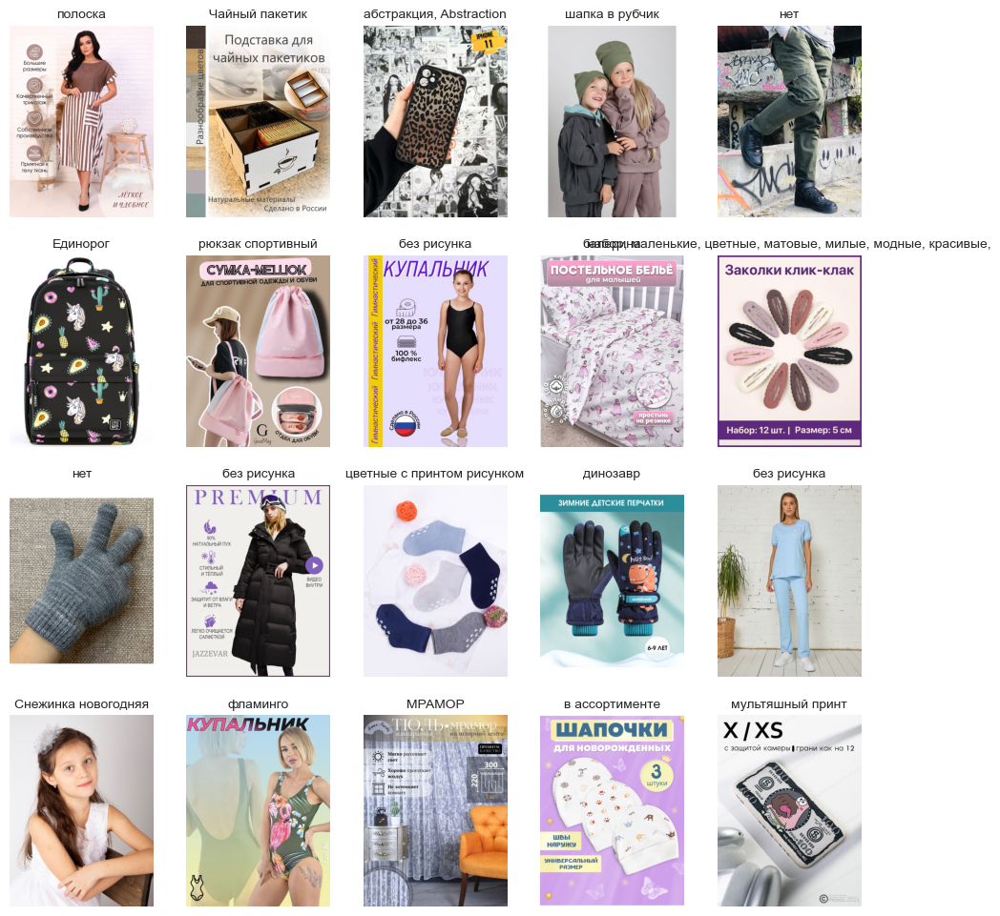

In [59]:
check_caption = train[['nm']].merge(characteristics.image, left_index=True, right_index=True).dropna()

plot_images(path_to_zip, check_caption.nm.apply(lambda x: str(x) + '.jpg').head(20), 
            titles=check_caption.image.head(20).values, hspace=0.2, bgr_to_rgb=True)

Данная характеристика плохо описывает картинки, в дальнейшем не будем ее использовать.

#### Сезонность

In [60]:
# просмотрим характеристику сезонности
characteristics['season'].dropna().head(20)

17                        круглогодичный
20                     [демисезон, зима]
25     [круглогодичный, лето, демисезон]
49                     [зима, демисезон]
72                             демисезон
89     [демисезон, круглогодичный, зима]
104                       круглогодичный
118                    [зима, демисезон]
126    [лето, круглогодичный, демисезон]
182                    [демисезон, лето]
196                    [зима, демисезон]
198                    [зима, демисезон]
216                    [демисезон, зима]
232                       круглогодичный
234                       круглогодичный
262                                 зима
276    [демисезон, зима, круглогодичный]
288                                 зима
295    [лето, демисезон, круглогодичный]
297                                 зима
Name: season, dtype: object

In [61]:
# обработаем списки сезонных характеристик
characteristics['season'] = characteristics.season.apply(lambda x: get_from_list(x, ['круглогодичный', 'демисезон']))

Число товаров с указанием сезонности: 9997 (10.1%)


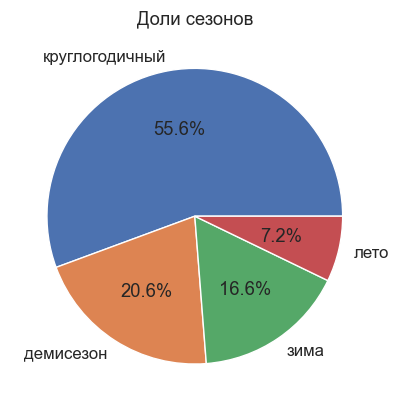

In [62]:
season_freqs = characteristics.season.value_counts()
print(f'Число товаров с указанием сезонности: {season_freqs.sum()} ({season_freqs.sum() / len(train) * 100:.1f}%)')
plot_pie(season_freqs, 'Доли сезонов', season_freqs.index, '%1.1f%%')

In [63]:
# посмотрим несколько записей, которые содержат характеристику сезонности
train[['description_lemmatized']].merge(characteristics[['season']], left_index=True, right_index=True).dropna().head(10)

,description_lemmatized,season
17,уважаемые покупатели аквашузы маломерят на 1 р...,круглогодичный
20,шапка для мальчик и шапка для девочка из трико...,демисезон
25,маломерят \n стильный карго штаны сшить из хло...,круглогодичный
49,впуховик женский зимний самая популярный одежд...,зима
72,демисезонный ботильоны молочный цвет олицетвор...,демисезон
89,женский вязаный шапка чепчик фэшн стильный гол...,круглогодичный
104,зимний повязка на голова из флиса Отлично подх...,круглогодичный
118,демисезонный комбинезон для новорожденных подх...,зима
126,любимый покупатель ситуация с тем что приходит...,круглогодичный
182,дино жилет для мальчик и девочка на лето весна...,демисезон


Данная характеристика будет неплохим признаком, описывающим одежду и другие сезонные товары. Из записей выше видно, что сезонность часто указывается и в описании. Можно попробовать провести поиск с указанием сезонности по уникальным значениям карактеристики.

In [64]:
# проводим поиск по ключевым словам из season
pattern = re.compile('|'.join(season_freqs.index))
res = train.description_lemmatized.apply(lambda x: Counter(re.findall(pattern, x)).most_common(1))
res = res.apply(lambda x: x[0][0] if x else None)
res = res.to_frame()
res['nm'] = train.nm

# объединаяем полученные данные с характеристиками
res = res.merge(characteristics[['nm', 'season']], left_on='nm', right_on='nm')
res = res[~(res.season.isna()) | ~(res.description_lemmatized.isna())]

display(res[['description_lemmatized', 'season']].head(10))
print('Число записей с указанием сезонности: ', res.shape[0])

,description_lemmatized,season
9,лето,None
17,None,круглогодичный
20,зима,демисезон
25,лето,круглогодичный
49,зима,зима
69,демисезон,None
72,демисезон,демисезон
77,лето,None
89,демисезон,круглогодичный
104,None,круглогодичный


Число записей с указанием сезонности:  14801


Мы получили чуть больше информации. Правда иногда полученная из описания информация не соответствует указанной харакетристике. Полученные данные можно использовать как фичу или как таргет.

#### Материал изделия

In [65]:
characteristics['material'].dropna()

11                                      мдф ламинированный
12                      Силикон+ABS пластик, Пластик (ABC)
19                        [фатин, кружево, Репсовая лента]
23                  [акрил, дерево, синтетическое полотно]
24                                        Полиэстер Хлопок
                               ...                        
99285                               ПОЛИПРОПИЛЕН,ПОЛИЭСТЕР
99291    [Чехол со стразами на Samsung A12 / Samsung M1...
99292                       [abs-пластик, прочный пластик]
99299                              [пластик, полипропилен]
99304                                              пластик
Name: material, Length: 25697, dtype: object

Доля записей с указанием материала: 25.9%


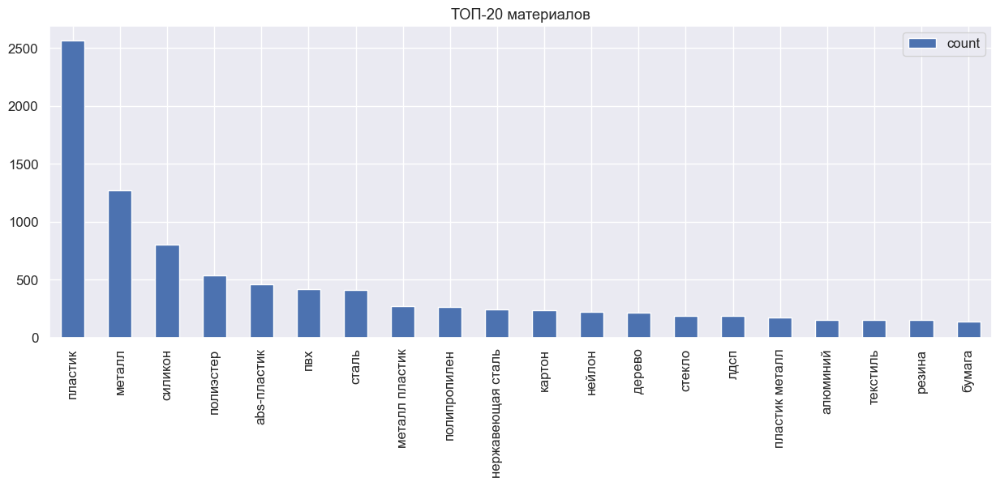

In [66]:
# в характеристике material присутсвуют списки, преобразуем их в строки
characteristics['material'] = characteristics.material.apply(lambda x: ' '.join(x) if isinstance(x, list) else x)
print(f'Доля записей с указанием материала: {characteristics.material.count() / len(train) * 100:.1f}%')

material_counts = Counter(', '.join(characteristics.material.dropna().str.lower()).split(', '))
material_counts = Counter({k: v for k, v in material_counts.items()if k not in punctuation})


plot_freqs(material_counts.most_common(20), title='ТОП-20 материалов')

С одной стороны кажется, что по картинкам можно предсказывать материал, с другой часто встречаются многокомпонентные товары, и материалов очень много. Скорее всего данную характеристику не удастся использовать.

#### Срок годности

In [67]:
# посмотрим на характеристику срока годности
characteristics['expiry_date'].apply(lambda x: x[0] if isinstance(x, list) else x).dropna().value_counts()

24 месяца                    1244
36 месяцев                    720
12 месяцев                    649
2 года                        580
18 месяцев                    490
                             ... 
5 мес с даты производства       1
18 - мес                        1
36+                             1
520 дней                        1
02/25                           1
Name: expiry_date, Length: 617, dtype: int64

Видим крайне большое написание вариантов срока годности. Данную характеристику можно использовать как маркер указан ли срок годности у товара (True/False).

In [68]:
characteristics['expiry_date'] = characteristics.expiry_date.apply(lambda x: True if x is not None else False)

In [69]:
print('Число товаров с указанием срока годности: ', characteristics.expiry_date.sum())

Число товаров с указанием срока годности:  7809


In [70]:
# укажем какие характеристики в дальнейшем не будем использовать
chars_to_drop = ['pack_weight', 'pack_length', 'pack_width', 'pack_height', 'item_length', 'item_width', 'item_height', 'image']

# объединяем тренировочные данные и выбранные характеристики
train = train.merge(characteristics.drop(chars_to_drop, axis=1), on='nm', how='left').drop('characteristics', axis=1)

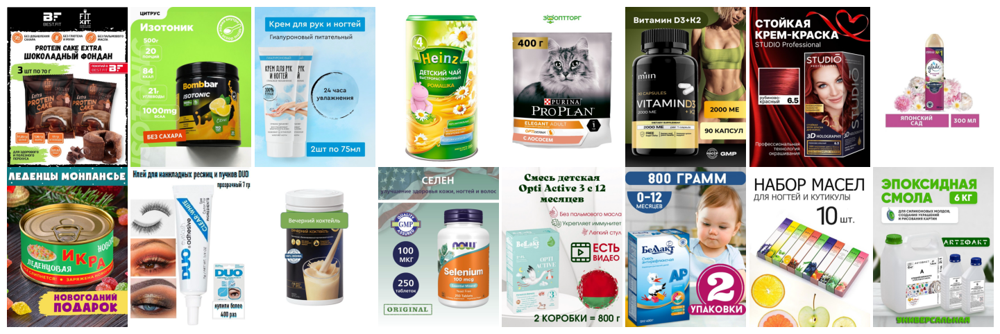

In [71]:
# посмотрим на картинки товаров со сроком годности
plot_images(path_to_zip, train[train.expiry_date == True].nm.apply(lambda x: str(x) + '.jpg').head(16), bgr_to_rgb=True, cols=8)

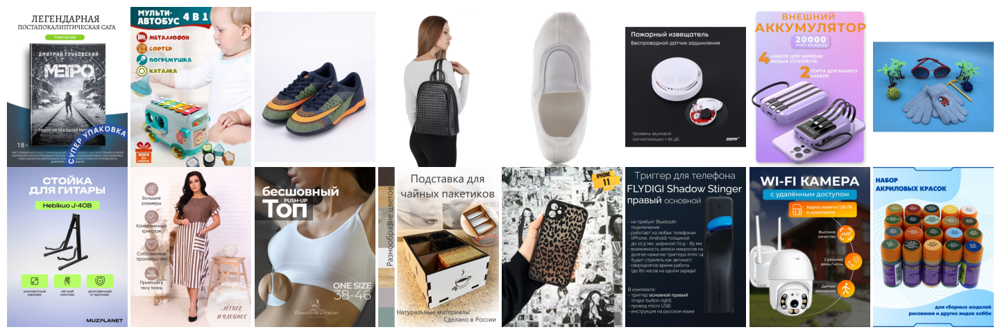

In [72]:
# посмотрим на картинки товаров у которых не указан срок годности
plot_images(path_to_zip, train[train.expiry_date == False].nm.apply(lambda x: str(x) + '.jpg').head(16), bgr_to_rgb=True, cols=8)

Возможно данная характеристика будет полезной фичой.

#### Хрупкость

In [73]:
print('Товаров с указанием характеристики "Хрупкость": ', characteristics[characteristics.fragility.apply(type) != list].fragility.dropna().shape[0])

Товаров с указанием характеристики "Хрупкость":  7479


In [74]:
# посмотрим что пишут в данной характеристике
uniq_str = characteristics[characteristics.fragility.apply(type) != list].fragility.dropna().apply(lambda x: x.lower()).unique()
uniq_str

array(['хрупкое', 'не хрупкое', 'хрупкая (надежно защищена)',
       'не хрупкий груз', 'хрупкий груз', 'не бросать',
       'хрупкое (надежно упаковано)', 'да', 'умеренно хрупкое',
       'надежная конструкция', 'хрупкий товар',
       'хрупкий товар, не бросать', 'хрупкий ( надежно упаковано )',
       'хрупко', 'низкая', 'не хрупкий', 'хрупкое, надежно упаковано',
       'не хрупкий,', 'прочный пластик', 'нет',
       'хрупкая надежно защищена', 'хрупкий предмет',
       'хрупкое (надёжно упаковано)', 'средней хрупкости',
       'в защитной упаковке', 'не хрупкий, надёжно упакован',
       'не хрупкий надёжно упакован', 'не хркпкое', 'высокопрочный',
       'хрупкое (безопасная, прочная упаковка)', 'хрупкий',
       'хрупкий (надежно упаковано).', 'надежно упакован не хрупкое',
       'не бросать,не давить,не складывать', 'хрупкое (хорошо упаковано)',
       'хрупкая (надежно упаковано)', 'не хруп',
       'не хрупкий надежно упакован',
       'не хрупкое хорошо упаковано быстрая до

И снова придется страдать с обработкой столь разных вариантов записи.

In [75]:
def get_fragility(x):
    if re.match(r'не х[рупкое]+|нет|прочн|над[её]ж', x) is not None:
        return 'не хрупкий'
    elif re.match(r'х[рупкое]+|да|не брос', x) is not None:
        return 'хрупкий'
    else:
        return 'не хрупкий'

In [76]:
fragility = characteristics[characteristics.fragility.apply(type) != list].fragility.dropna()
fragility = fragility.apply(get_fragility)

# обрабатываем записи со списками
fragility_lists = characteristics[characteristics.fragility.apply(type) == list].fragility
fragility_lists = fragility_lists.apply(lambda x: set([get_fragility(i) for i in x])).apply(lambda x: list(x)[0] if len(x) == 1 else None)

characteristics['fragility'] = pd.concat([fragility, fragility_lists])

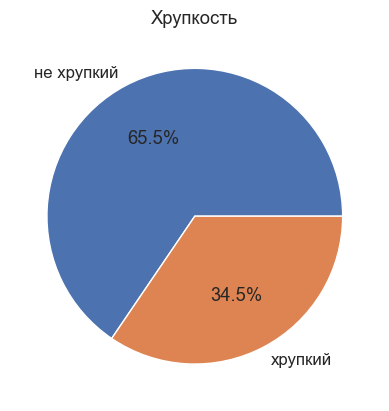

In [77]:
fragility_freqs = characteristics['fragility'].dropna().value_counts()
plot_pie(fragility_freqs, 'Хрупкость', fragility_freqs.index, '%1.1f%%')

Можно будет использовать в качестве прокси-метрики

### Промежуточные выводы

- Пропуски в описании можно заполнить текстом заголовка;
- Имеются дубликаты как по тройке заголовок-описание-характеристики, так и по каждому признаку в отдельности. Для каждого дубликата картинки идентичны и могут отличаться по цвету/форме товара, его описанию, представленному на самой картинке;
- Для всех товаров имеется соответствующий файл .jpg;
- Стоит удалить из рассмотрения товары, для которых заголовок содержит только один символ;
- Если для извлечения эмбеддингов из текста использовать трансформеры, придется сильно сокращать описания или выделять из них только отдельную информацию, поскольку они часто очень длинные и могут не вписывается в ограничения длины входных данных;  
- Для получения имени бренда, категории товара, страны производства можно использовать распознование именованных сущностей;
- В заголовках и описании часто встречаются словосочетания "для <слово>", которые можно использовать для обозначения (под)категорий;
- Также в описании часто можно встретить указание на пол, для которого предназначен товар, что можно извлечь и использовать в дальнейшем;
- Разнообразие характеристик товара огромно, однако заполняются чаще всего только страна производства, параметры упаковки/товара (длина, ширина, высота, вес), состав, для кого предназначен товар (пол), информацию о сертификатах и НДС. Часть характеристик можно использовать при обучении: пол, возрастные ограничения, размеры упаковок и вес товара, сезонность, срок годности. Однако они выглядят не полными и стоит дозаполнять данные с использованием анализа описаний.

In [78]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99308 entries, 0 to 99307
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   nm                      99308 non-null  int64 
 1   title                   99308 non-null  object
 2   description             99308 non-null  object
 3   title_lemmatized        99308 non-null  object
 4   description_lemmatized  99308 non-null  object
 5   ner_title               99308 non-null  object
 6   ner_description         99308 non-null  object
 7   description_for         99308 non-null  object
 8   country                 93191 non-null  object
 9   sex                     22788 non-null  object
 10  age_restrictions        99308 non-null  object
 11  season                  9997 non-null   object
 12  material                25697 non-null  object
 13  expiry_date             99308 non-null  bool  
 14  fragility               8596 non-null   object
dtypes:

## Анализ test данных

In [79]:
get_main_info(test)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30000 entries, 24345 to 82123
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   nm            30000 non-null  int64  
 1   title         29876 non-null  object 
 2   brand         29657 non-null  object 
 3   sub_category  30000 non-null  object 
 4   category      30000 non-null  object 
 5   description   29928 non-null  object 
 6   isadult       30000 non-null  bool   
 7   price         582 non-null    float32
dtypes: bool(1), float32(1), int64(1), object(5)
memory usage: 82.4 MB

Пропуски в колонке:
             nm:   0 (0.00%)
          title: 124 (0.41%)
          brand: 343 (1.14%)
   sub_category:   0 (0.00%)
       category:   0 (0.00%)
    description:  72 (0.24%)
        isadult:   0 (0.00%)
          price: 29418 (98.06%)

Число полностью дублируюшихся записей: 0
Число дубликатов по:
                                 nm:     0 (0.00%)
                 

В колонке `price` более 98% пропусков, использовать её не получится, поэтому в дальнейшем рассматривать ее не будем. Как и в случае с train датасетом заполним пропуски в `description` данными из `title`, где это возможно. Дубликатов по `title` около 7%, однако парных дублликатов `title-description` существенно меньше (около 2%). 

In [80]:
test = test.drop('price', axis=1)  # удуаляем колонку price

In [81]:
# заполним None и пустые строки в description используя title, где это возможно
condition = (test.description.isna() | (test.description == ''))
test.loc[condition, 'description'] = test.loc[condition, 'title']

# посмотрим, сколько осталось записей без заголовка и описания
condition = (test.title.isna() | (test.title == '')) & (test.description.isna() | (test.description == ''))
print('Число записей без заголовка и описания:', test[condition].shape[0])

Число записей без заголовка и описания: 13


In [82]:
# удалим записи без описания и заголовка
test = test[test.title.notna()]

In [83]:
# оставшиеся пропуски в title заполним используя sub_category, brand и isadult
condition = test.title.isna()
adult = test.loc[condition, 'isadult'].apply(lambda x: ', 18+' if x else '')
test.loc[condition, 'title'] = test.loc[condition, 'sub_category'] + ', ' + test.loc[condition, 'brand'] + adult

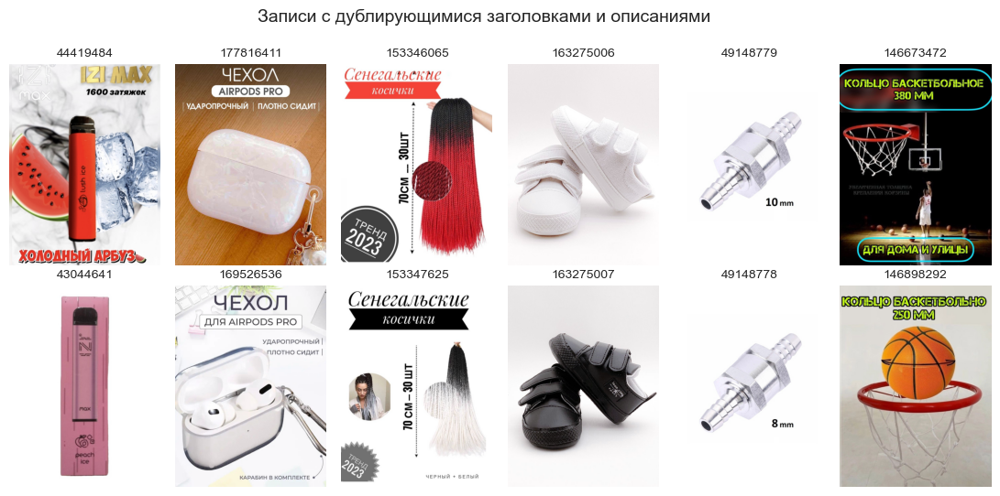

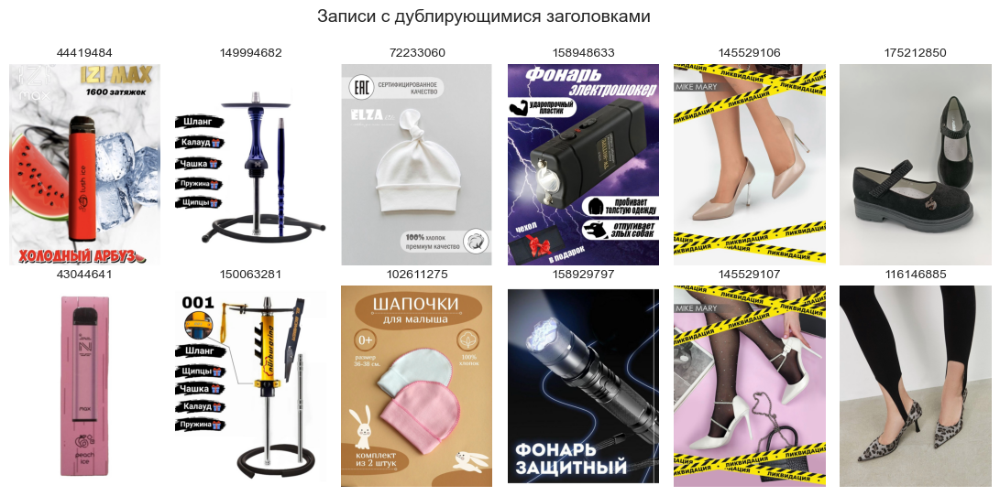

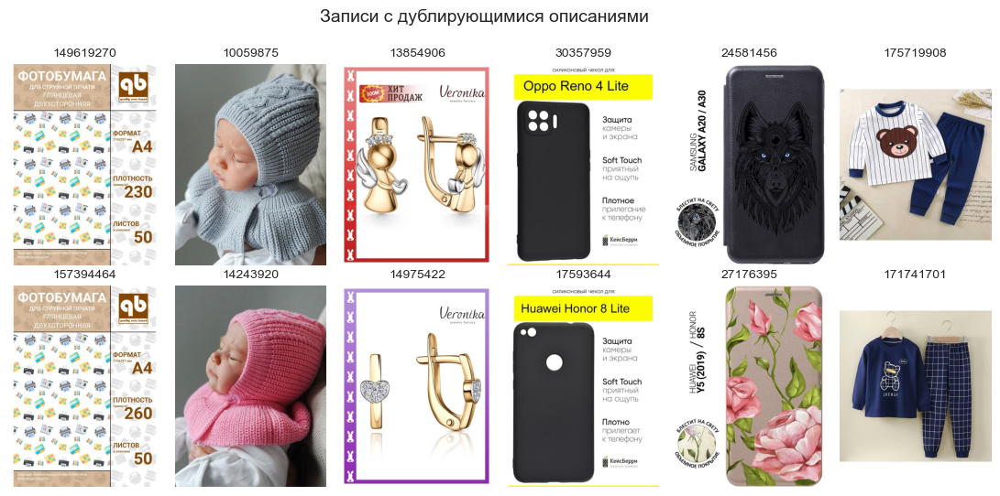

In [84]:
# посмотри на дубликаты по паре title-description, и по призакас в отдельности
for dup_cols, title in [
    (['title', 'description'], 'Записи с дублирующимися заголовками и описаниями'),
    (['title'], 'Записи с дублирующимися заголовками'),
    (['description'], 'Записи с дублирующимися описаниями'),
]:
    show_dup_pairs_by_images(test, dup_cols, title=title)
    print('\n')

Также как и в `train` для дубликатов картинки часто лишь немного отличаются: цветом товара, описанием, формой, рисунком и т.п.

In [85]:
num = test.nm.isin(image_df.nm).sum()
print(f'Доля записей из test для которых имеются изображения: {num} ({num / len(test) * 100:.1f}%)')

Доля записей из test для которых имеются изображения: 29876 (100.0%)


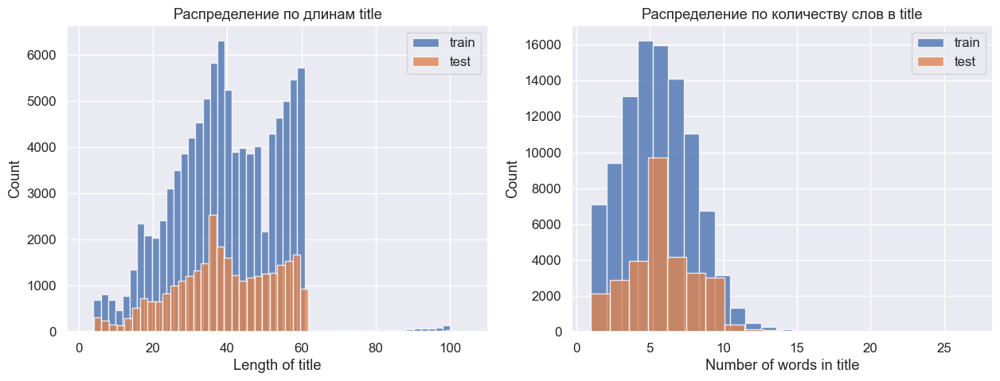

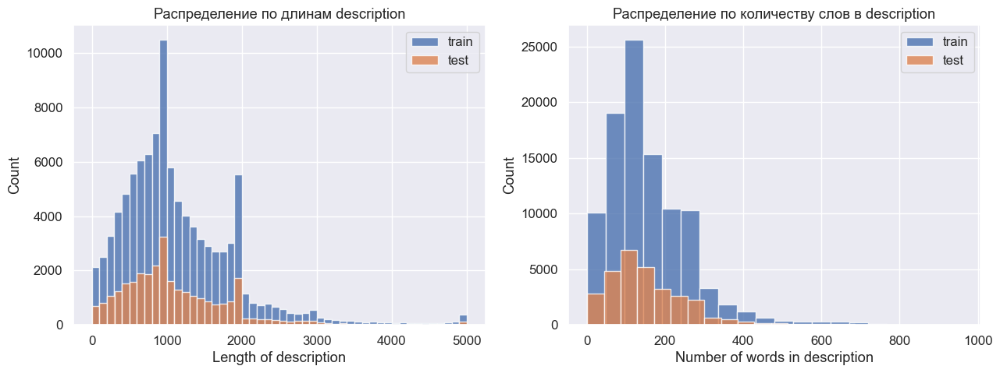

In [86]:
plot_lengths_distributions(train, 'title', data_2=test, labels=['train', 'test'])
plot_lengths_distributions(train, 'description', data_2=test, labels=['train', 'test'])

In [87]:
normalizer = TextNormalizer()

In [88]:
# %%time
# в среднем 30 минут
# test[['title_lemmatized', 'ner_title']] = normalizer.transform(test.title, ner=True)
# test[['description_lemmatized', 'ner_description']] = normalizer.transform(test.description, ner=True)

# test[['nm', 'title_lemmatized', 'description_lemmatized', 'ner_title', 'ner_description']].to_parquet('test_lemmatized.parquet', index=False)

In [89]:
test = test.merge(pd.read_parquet('test_lemmatized.parquet'), on='nm', how='left')

### Категории

Число уникальных категорий: 63


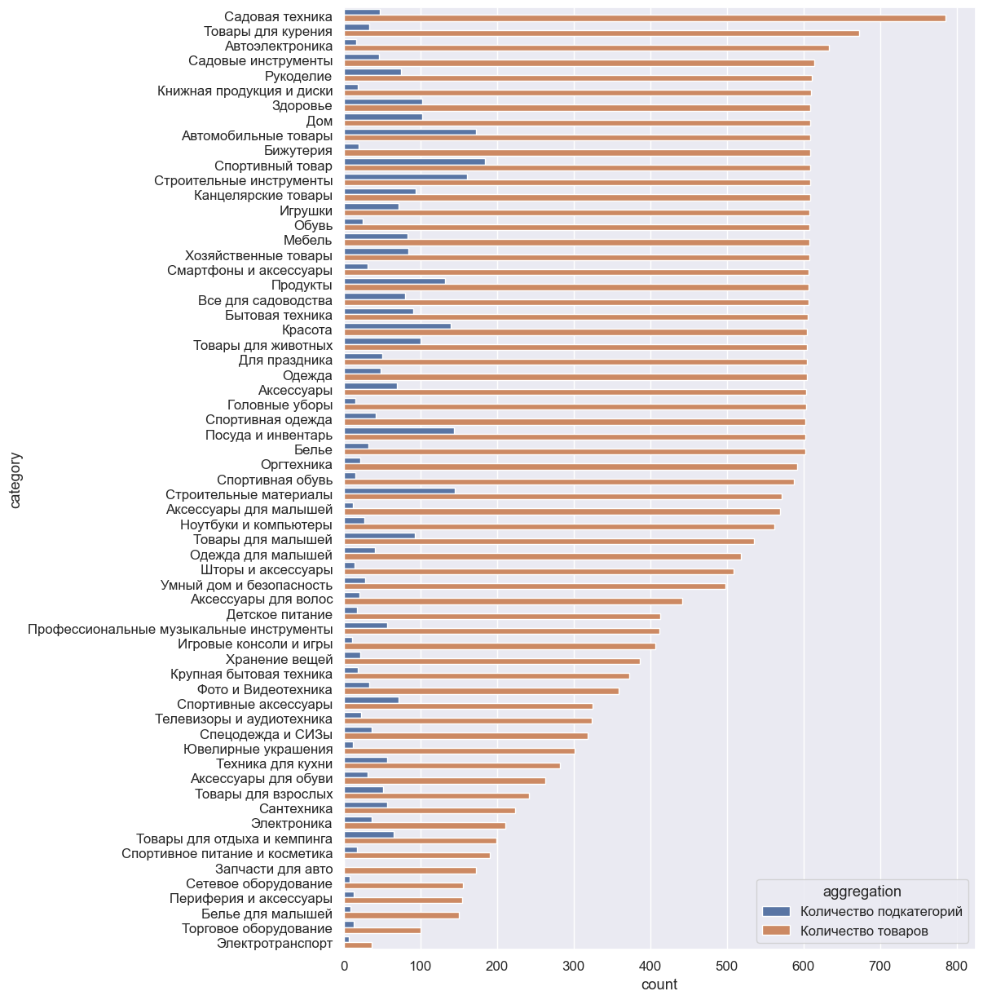

In [90]:
print('Число уникальных категорий:', test.category.str.lower().nunique())

# посчитаем для каждой категории число товаров и уникальных подкатегорий
subcat_freqs = test.groupby(['category']).sub_category.agg(['nunique', 'count'])\
                   .sort_values('count', ascending=False).rename(columns={'nunique': 'Количество подкатегорий', 'count': 'Количество товаров'})

reshaped = subcat_freqs.stack().reset_index()
reshaped.columns = ['category', 'aggregation', 'count']

plt.figure(figsize=(10, 15))
sns.barplot(data=reshaped, x='count', y='category', hue='aggregation');

Некоторые категории близки по смыслу, например "бытовая техника" и "крупная бытовая техника"; "спортивный товар", "спортивные аксессуары", "спортивная обувь". Также отсюда видно, что некоторые товары могут легко попадать в несколько категорий. Например спортивный костюм может попасть в категории "спортивный товар", "спортивная одежда", "одежда".
Большая часть категорий содержит около 600 товаров. 8 категорий содержат <= 200 товаров. Число подкатегорий в каждой категории не коррелирует с числом товаров. В категории "запчасти для авто" имеется только одна подкатегория, в которой, по сути, нет смысла.

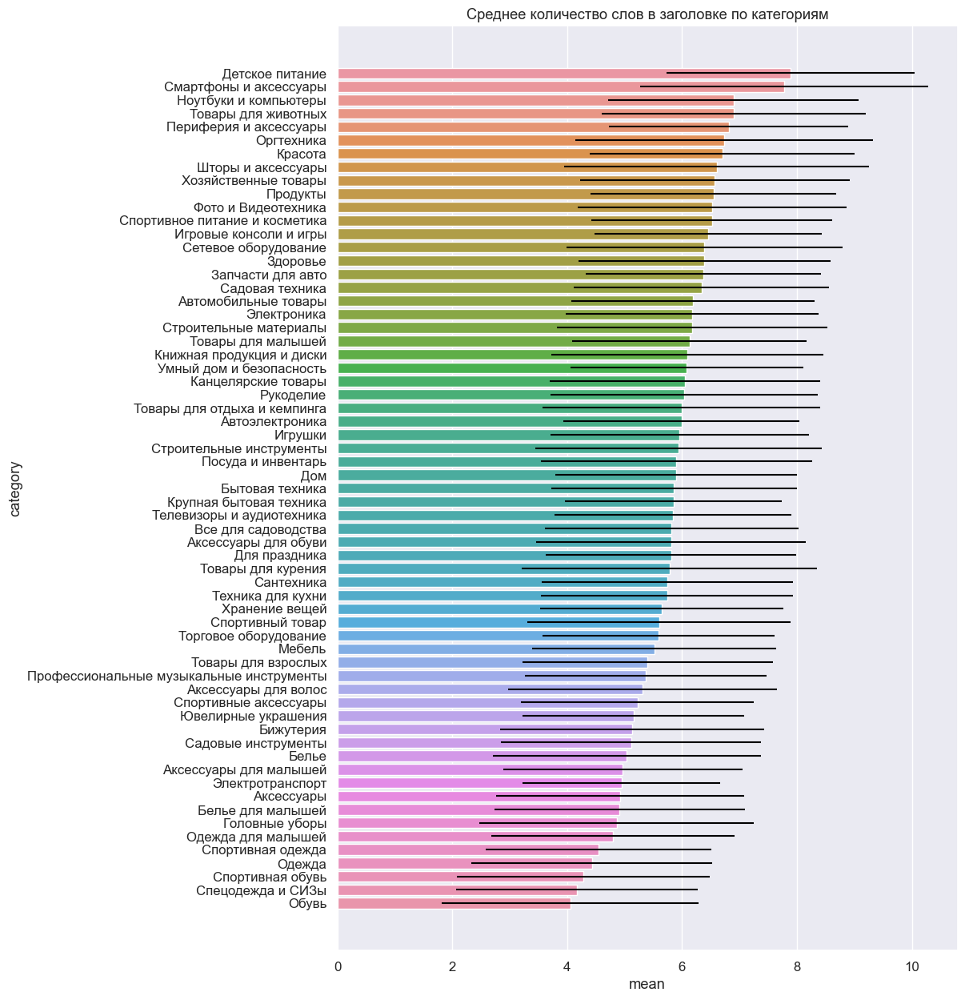

In [91]:
# для каждой категории также выведем среднее количество слов в заголовке
column = 'title'
cat_word_freqs = test.groupby(['category'])[column].apply(lambda x: np.mean([len(x.split()) for x in x])).to_frame()
cat_word_freqs.columns = ['mean']
cat_word_freqs['std'] = test.groupby(['category'])[column].apply(lambda x: np.std([len(x.split()) for x in x]))
cat_word_freqs = cat_word_freqs.reset_index().sort_values('mean', ascending=False)

plt.figure(figsize=(10, 15))
ax = sns.barplot(data=cat_word_freqs, x='mean', y='category')
ax.errorbar(data=cat_word_freqs, x='mean', y='category', xerr=cat_word_freqs['std'], color='black', ls='none')
plt.title('Среднее количество слов в заголовке по категориям');

Товары из категорий "детское питание" и "смартфоны и аксессуары" в среднем в заголовках имеют наибольшее число слов, а категории, связанные с одеждой и обувью - наименьшее.

In [92]:
print('Число уникальных подкатегорий:', test.sub_category.str.lower().nunique())

Число уникальных подкатегорий: 3400


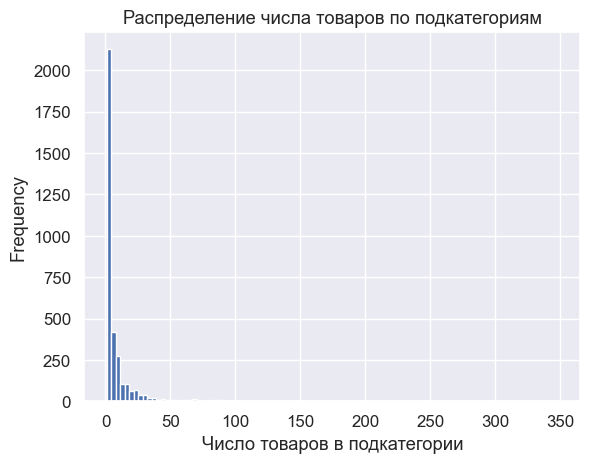

In [93]:
test.sub_category.value_counts().plot(kind='hist', bins=100)
plt.title('Распределение числа товаров по подкатегориям')
plt.xlabel('Число товаров в подкатегории');

Более чем в 2000 подкатегорий имеется лишь несколько единиц товаров.

In [144]:
subcat_freqs = test.sub_category.value_counts()
threshold = 65

print(f'Если задать условие, что в подкатегории должно быть больше {threshold} товаров, то останется:')
print('Товаров:', subcat_freqs[subcat_freqs > threshold].sum())
print('Подкатегорий:', subcat_freqs[subcat_freqs > threshold].count())

Если задать условие, что в подкатегории должно быть больше 65 товаров, то останется:
Товаров: 8235
Подкатегорий: 70


In [118]:
test[['category', 'sub_category']] = test[['category', 'sub_category']].astype('category')

При валидации по подкатегориям стоит исключить из рассмотрения "малонаселенные" подкатегории.

### Подкатегории и данные из train

Разовьем идею с поиском подкатегорий из лемматизированного описания.

In [95]:
# для начала необходимо получить лемматизированный список всех подкатегорий
subcats = test.sub_category.unique()

normalizer = TextNormalizer()
subcats_lemm = normalizer.transform(pd.Series(subcats), swifter=False)

  0%|          | 0/3400 [00:00<?, ?it/s]

In [96]:
subcats_lemm.tail(10)

3390                     компрессор
3391      безалкогольный шампанское
3392                 форма для мыло
3393               шкурка для скейт
3394     накладка для дверной ручка
3395    газовый плита туристический
3396              плед для животное
3397           колодки для мотоцикл
3398                горячий шоколад
3399             столик для ноутбук
dtype: object

Видно, что если опираться только на слово "для", то мы пропустим множество подкатегорий. Сделаем следующим образом: построим паттерн на основе всех доступных подкатегорий и будем искать совпадения в заголовке и описании. Мы наверняка получим некий набор подкатегорий. Далее можно выбирать одну подкатегорию по "частоте встречаемости".

In [97]:
pattern = re.compile(' ' + ' | '.join(subcats_lemm) + ' ')
train['sub_categories'] = train[['title_lemmatized', 'description_lemmatized']].dropna()\
                               .progress_apply(lambda x: Counter(map(lambda y: y.strip(), pattern.findall(x[0] + ' ' + x[1]))), axis=1)

  0%|          | 0/99308 [00:00<?, ?it/s]

In [98]:
display(train.sub_categories.head(10))
num = train[train.sub_categories == {}].sub_categories.count()
print(f'\nЧисло товаров, для которых не удалось извлечь подкатегории: {num} ({num / len(train) * 100:.1f}%)')

0                                                   {}
1    {'ксилофон': 1, 'машинка': 1, 'каталка': 1, 'п...
2           {'шиповки': 2, 'бутсы': 2, 'кроссовки': 1}
3                                         {'сумка': 1}
4                            {'чешка': 3, 'платье': 1}
5                             {'датчик задымление': 2}
6    {'кабель': 5, 'внешний аккумулятор': 1, 'планш...
7                        {'перчатка': 3, 'варежка': 6}
8    {'стойка для музыкальный инструмент': 1, 'защи...
9                                        {'платье': 5}
Name: sub_categories, dtype: object


Число товаров, для которых не удалось извлечь подкатегории: 10245 (10.3%)


Почти для 13% товаров не удалось извлечь подкатегорию. Возможно, недостающие категории можно достать из картинок путем детекции объектов на них. Также еще одна проблема - это подкатегории одинаковой частотности. В таком случае не совсем понятно, какую именно стоит выбирать. Возможное решение - выбирать на основе частотности подкатегорий, которую мы получили на предыдущем шаге при анализе test датасета (правда уже смахивает на утечку данных). А если и там частотность будет одинакова, то выбор можно проводить рандомно.

Все проделанное выше можно повторить и для категорий.

In [99]:
cats = test.category.unique()
cats_lemm = normalizer.transform(pd.Series(cats), swifter=False)
cats_lemm.head(10)

  0%|          | 0/63 [00:00<?, ?it/s]

0        бытовой техника
1      спортивный одежда
2                 одежда
3    аксессуар для обувь
4      спецодежда и сизы
5    аксессуар для волос
6       одежда для малыш
7     посуда и инвентарь
8    ноутбук и компьютер
9    хозяйственный товар
dtype: category
Categories (63, object): ['автомобильный товар', 'автоэлектроника', 'аксессуар', 'аксессуар для волос', ..., 'шторы и аксессуар', 'электроника', 'электротранспорт', 'ювелирный украшение']

In [100]:
pattern = re.compile(' ' + ' | '.join(cats_lemm) + ' ')
train['categories'] = train[['title_lemmatized', 'description_lemmatized']].dropna().progress_apply(lambda x: Counter(map(lambda y: y.strip(), pattern.findall(x[0] + ' ' + x[1]))), axis=1)

  0%|          | 0/99308 [00:00<?, ?it/s]

In [101]:
display(train.categories.head(10))
print('\nЧисло товаров, для которых не удалось извлечь категории:', train[train.categories == {}].categories.count())

0                 {'одежда': 1}
1                {'игрушка': 5}
2                  {'обувь': 2}
3                            {}
4                            {}
5                            {}
6                            {}
7                            {}
8    {'дом': 2, 'аксессуар': 1}
9       {'одежда': 1, 'дом': 1}
Name: categories, dtype: object


Число товаров, для которых не удалось извлечь категории: 46924


В пайплайне обработки данных необходимо будет объединить поиск категорий/подкатегорий, чтобы не выполнять одну и ту же работу дважды.<br>
Сразу видно, что категории извлекаются не так удачно как подкатегории.

Проверим работу алгоритма на тестовом датасете.

In [102]:
pattern = re.compile(' ' + ' | '.join(subcats_lemm) + ' ')
extracted_subcats = test[['title_lemmatized', 'description_lemmatized']].dropna()\
                               .progress_apply(lambda x: Counter(map(lambda y: y.strip(), pattern.findall(x[0] + ' ' + x[1]))), axis=1)

  0%|          | 0/29876 [00:00<?, ?it/s]

In [103]:
detected_ind = extracted_subcats[extracted_subcats != {}].index
lemm_to = {y: x for x, y in list(zip(subcats, subcats_lemm))}
res = (test.loc[detected_ind].sub_category == extracted_subcats.loc[detected_ind].apply(lambda x: lemm_to[x.most_common(1)[0][0]])).sum() / len(detected_ind) * 100

print('Доля совпадений: {:.1f}%'.format(res))

Доля совпадений: 33.8%


Как видим, данный подход лучше не применять к определению подкатегорий в обучающей выборке.

### Товары для взрослых

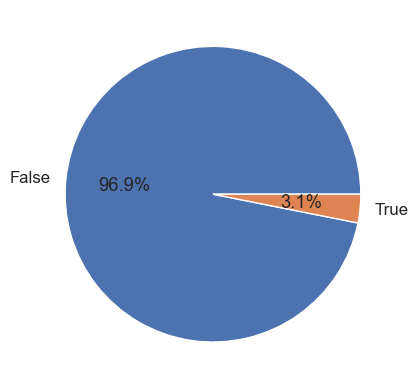

In [104]:
# выведем процент товаров с указанием "для взрослых"
isadult_freqs = test.isadult.value_counts()
plot_pie(isadult_freqs, '', isadult_freqs.index, '%1.1f%%')

In [105]:
# выведем список категорий, для товаров в которых указывают возрастное ограничение
print('Категории с товарами для взрослых и количество товаров в них:')
for cat in test.query('isadult == True').category.unique():
    print(f'- {cat} ({test.query("isadult == True and category == @cat").shape[0]})')

Категории с товарами для взрослых и количество товаров в них:
- Товары для курения (673)
- Товары для взрослых (239)
- Здоровье (15)
- Продукты (2)
- Посуда и инвентарь (2)
- Книжная продукция и диски (1)


Если с категориями "товары для курения", "товары для взрослых", "книжная продукция и диски" всё более-менее понятно, то для остальных интересно посмотреть что в них входит. 

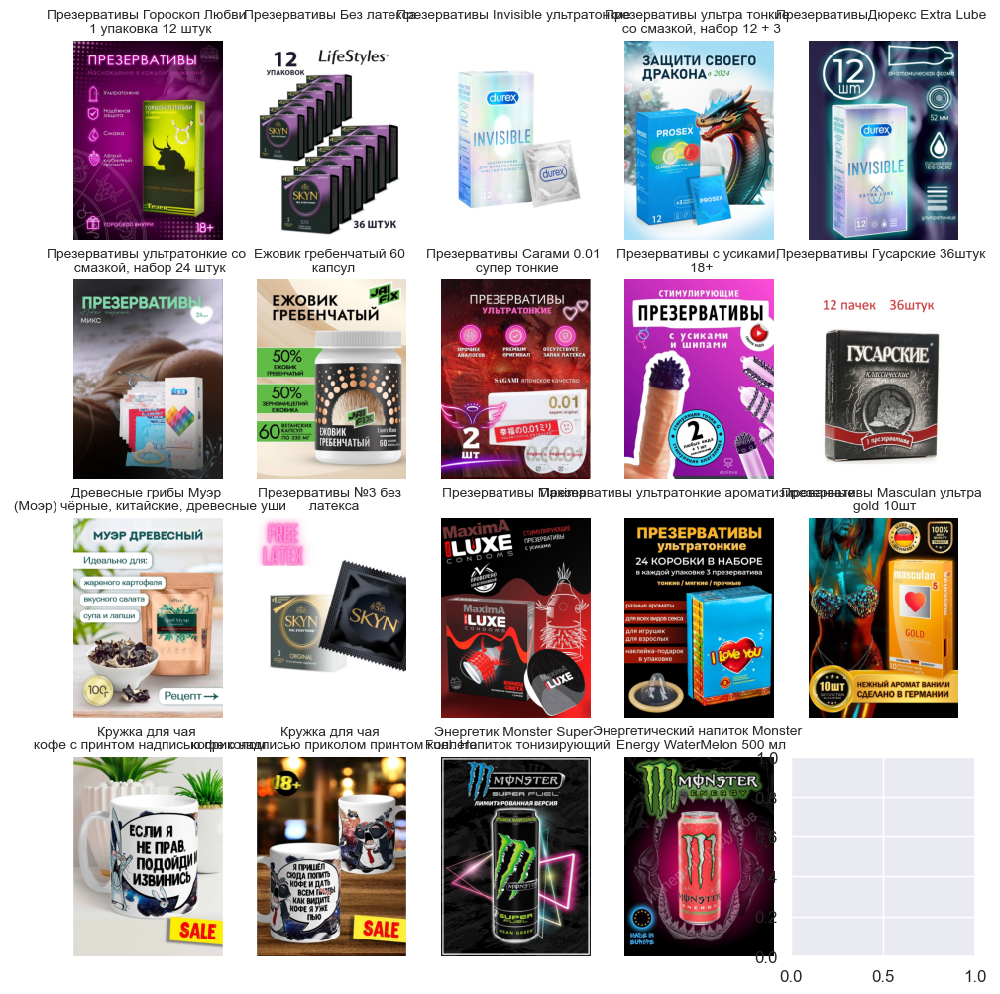

In [106]:
adult_by_cats = test.query('isadult == True and category in ["Продукты", "Посуда и инвентарь", "Здоровье"]').sort_values('category')
titles = []
for title in adult_by_cats.title.head(20).values:
    title = title.split()
    title.insert(3, '\n')
    titles.append(' '.join(title))

plot_images(path_to_zip, adult_by_cats.nm.apply(lambda x: str(x) + '.jpg').head(20),
            titles=titles, hspace=0.2, bgr_to_rgb=True)

В случае "посуды и инвентаря" - это принты со "взрослыми" налписями, в случае продуктов - энергетики. Самое интересное из товаров для взрослых в категории "здоровье" - грибы. 

In [107]:
# посмотрим товары, которые входят в категории "товары для взрослых (курения)" но не отмечены isadult = True
condition = (test.category.isin(['Товары для взрослых', 'Товары для курения']) & (test.isadult == False))
test[condition]

,nm,title,brand,sub_category,category,description,isadult,title_lemmatized,description_lemmatized,ner_title,ner_description
13842,94436166,Настольная игра для пары подарок на годовщину ...,MAGIC JAR,Настольные игры для взрослых,Товары для взрослых,"Новинка от проекта Magic Jar, созданного психо...",False,настольный игра пара подарок годовщина февраль,новинка проект magic jar создать психолог елиз...,"{'LOC': None, 'ORG': None, 'PER': None}","{'LOC': ['тяните'], 'ORG': None, 'PER': ['елиз..."
16620,25614824,Мармелад жевательный 18+ сладости с приколом,Фабрика счастья,Мармелад эротик,Товары для взрослых,Закончились идеи чем удивить друзей на вечерин...,False,мармелад жевательный + сладость прикол,закончиться идея удивить друг вечеринка придум...,"{'LOC': None, 'ORG': None, 'PER': None}","{'LOC': None, 'ORG': None, 'PER': None}"
20617,94436167,"Настольная игра для двоих, пары, подарок на 14...",MAGIC JAR,Настольные игры для взрослых,Товары для взрослых,"Новинка от проекта Magic Jar, созданного психо...",False,настольный игра двое пара подарок февраль,новинка проект magic jar создать психолог елиз...,"{'LOC': None, 'ORG': None, 'PER': None}","{'LOC': ['тяните'], 'ORG': None, 'PER': ['елиз..."


In [108]:
# исправим эту ошибку
test.loc[condition, 'isadult'] = True

Стоит отметить, что признак сильно несбалансирован. Возможно при обучении необходимо будет провести балансировку классов (используя upsampling или downsampling + upsampling, со SMOTE редко когда что-то получается).

### Бренды

Число уникальных брендов: 18055
Число брендов, встречающихся только для 1-го товара: 13691


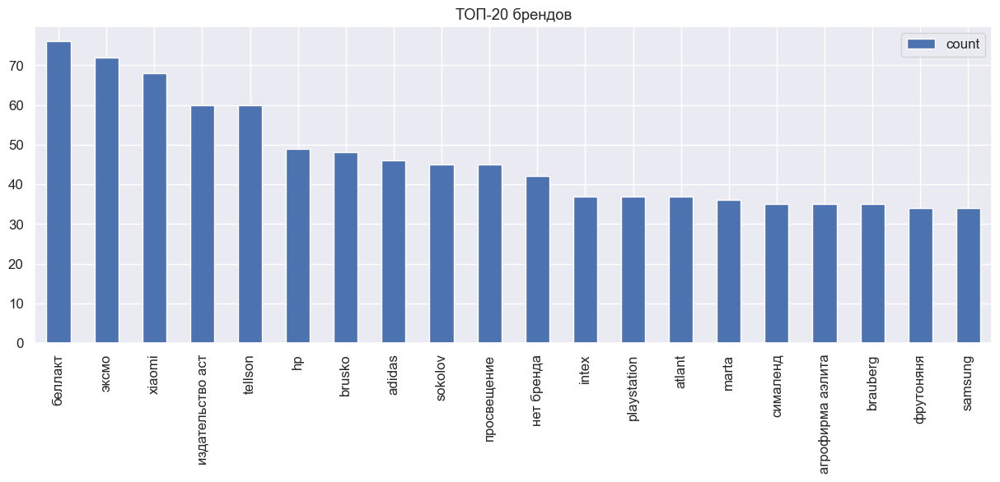

In [109]:
print('Число уникальных брендов:', test.brand.str.lower().nunique())

brand_freqs = test.brand.str.lower().value_counts().to_frame().reset_index().rename(columns={'index': 'brand', 'brand': 'count'})

print('Число брендов, встречающихся только для 1-го товара:', brand_freqs[brand_freqs['count'] == 1].shape[0])

plot_freqs(brand_freqs.head(20), col_names=['brand', 'count'], title='ТОП-20 брендов')

Брендов очень много, и для многих из них имеется лишь один товар (более 13 тыс.). Предсказание бренда кажется невозможной задачей.

### Промежуточные выводы

- колонка `price` содержит 98% пропусков, использовать ее для оценки стоимости товара не получится;
- пропуски в описаниях заполнили текстом из заголовка, где это было возможно, остальные товары с пропусками в заголовке исключили из рассмотрения;
- проанализировали дубликаты по паре заголовок-описание, так и по каждой из этих колонок по отдельности. Как и в train датасете, картинки для данных записей идентичны и содержат чаще всего незначительные изменения: цвета, формы, описания (которое присутсвует на картинке), размером товара;
- распределение длин текста и количества слов в заголовках и описаниях идентичны таковым в трейм датасете;
- товары разбиты на 63 категории и 3405 подкатегорий. Чаще всего в категории около 600 товаров. Корреляции между количеством товаров в категории и количеством подкатегорий нет. Более чем в 2000 подкатегорий находятся лишь единицы товаров, предсказывать подкатегорию в таком случае будет сложно, если не невозможно. Для 90% товаров в train можно извлечь информацию о подкатегории;
- Указание isadult=True присутствует для 3.1% товаров. Имелось три товара, которые попадали в категорию "товары для взрослых", но имели isadult=False;
- Число уникальных брендов сравним с размеров test датасета. Предсказывать бренд товара не представляется возможным с таким маленьким количеством единиц товара на каждый бренд.

# Основной вывод

- необходимо учитывать, что изображения сохранены с цветовой схемой BGR, часть из них имеет нестандартные размеры (меньше 900 x 1200). Для каждой записи в train и test имеется картинка;
- пропусков в train данных немного, поэтому их можно просто удалить. В качестве дополнительных фичей можно добавить некоторые характеристики: страна производства, размеры упаковки и вес товара, сезонность, срок годности. В качестве таргета можно использовать характеритики "пол", "возрастные ограничения", "сезонность". Дозаполнить данные по характеристикам в некоторых случаях можно будет с помощью поиска информации в описании по ключевым словам. Нужно будет учитывать дисбаланс классов при обучении. Для оценки качества обучения модели можно будет использовать также данные из заголовка и описания: извлечь именованные сущности с тэгом 'ORG', извлечь все словосочетания "<слово> для <слово>";
- пропусков в тестовых данных также немного, их можно просто удалить. Не получится использовать `price` и `brand` при валидации, поскольку в первом случае пропусков 98%, а во втором число брендов сравнимо с размером всего тестового датасета. С подкатегориями также необходимо поработать (например объединить похожие), поскольку имеется большое количество подкатегорий, в которых находятся лишь единицы товаров. Категории также бывают очень похожими по смыслу. Признак `isadult` сильно несбалансирован, возможно придется проводить балансировку. 

Для обучения можно провести аугментацию данных: сохраняя текст в заголовке и описании изменять картинку (цвет, кроп, флип и т.п.) либо одновременно проводить изменения в тексте (простое урезание текста, оставлять только именованные сущности, добавлять характеристики в текст и т.п.).